 #              <font color = red size =15> Telecom Churn - Group Case Study</font>

<font color = Brown size = 5>  __Problem Statement :__


__To reduce customer churn, telecom companies need to predict which customers are at high risk of churn.__
- Analyse customer-level data of a leading telecom firm, build predictive models to identify customers at high risk of churn and identify the main indicators of churn.


<font color = Goldgrey size = 5> Business Objective</font>

- The business objective is to predict the churn in the last (i.e. the ninth) month using the data (features) from the first three months. 
- To do this task well, understanding the typical customer behaviour during churn will be helpful.

<font color=Green size = 5>
Actions Performed For Solution :</font>

    1. Data Preparation : Data Sourcing & validation , Deriving New Features
    2. Data Imputation & Cleaning of Missing values.
    3. Filter High-Value Customers
    4. Tag Churners & Remove churnphse attributes.
    5. Exploratory Data Analysis
    6. Analyzing Target Variable.
    7. Outlier Treatments  
    8. Modeling - Logistic Regression with RFE(base model), {Desicion Tree, Random Froest, Logistic}-With 
       PCA 

In [163]:
# Importing all basic packages
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings("ignore")
pd.options.display.float_format = '{:.2f}'.format

In [2]:
# Importing all required packages
from datetime import date
import statsmodels.api as sm
from scipy import stats
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.model_selection import train_test_split,cross_val_score
from sklearn.feature_selection import RFE
from sklearn.linear_model import LinearRegression
from sklearn import linear_model
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.model_selection import GridSearchCV,KFold
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler,MinMaxScaler

<font size = 5 color = Skyblue> **Data Preparation:** </font>    
<br>

<font size = 5 color = Brown> **Data Sourcing:** </font>    

In [3]:
# importing data to the jupyter notebook
data = pd.read_csv('telecom_churn_data.csv')

data.head()

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,last_date_of_month_9,arpu_6,...,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g
0,7000842753,109,0.00,0.00,0.00,6/30/2014,7/31/2014,8/31/2014,9/30/2014,197.38,...,0,1.00,1.00,1.00,nan,968,30.40,0.00,101.20,3.58
1,7001865778,109,0.00,0.00,0.00,6/30/2014,7/31/2014,8/31/2014,9/30/2014,34.05,...,0,nan,1.00,1.00,nan,1006,0.00,0.00,0.00,0.00
2,7001625959,109,0.00,0.00,0.00,6/30/2014,7/31/2014,8/31/2014,9/30/2014,167.69,...,0,nan,nan,nan,1.00,1103,0.00,0.00,4.17,0.00
3,7001204172,109,0.00,0.00,0.00,6/30/2014,7/31/2014,8/31/2014,9/30/2014,221.34,...,0,nan,nan,nan,nan,2491,0.00,0.00,0.00,0.00
4,7000142493,109,0.00,0.00,0.00,6/30/2014,7/31/2014,8/31/2014,9/30/2014,261.64,...,0,0.00,nan,nan,nan,1526,0.00,0.00,0.00,0.00


<font size = 5 color = Brown> **Data Inspection:** </font>    
    <br>

In [4]:
#Metrics about input data: Datatypes, size & shape
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99999 entries, 0 to 99998
Columns: 226 entries, mobile_number to sep_vbc_3g
dtypes: float64(179), int64(35), object(12)
memory usage: 172.4+ MB


<font size = 5 color = blue> **Inference:** </font>  

- **Here there are 3 types in data : int,float : Numerical & object: Categorical.**
- **But need to find the real types of these columns by doing some visualization.**
- **Data shape is 99999 rows & 226 columns.**

In [5]:
#Numeric features stats:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
data.describe()

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,onnet_mou_9,offnet_mou_6,offnet_mou_7,offnet_mou_8,offnet_mou_9,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_ic_mou_9,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,roam_og_mou_9,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2t_mou_9,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2m_mou_9,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2f_mou_9,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_t2c_mou_9,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,loc_og_mou_9,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2t_mou_9,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2m_mou_9,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2f_mou_9,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_t2c_mou_9,std_og_mou_6,std_og_mou_7,std_og_mou_8,std_og_mou_9,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,isd_og_mou_9,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,spl_og_mou_9,og_others_6,og_others_7,og_others_8,og_others_9,total_og_mou_6,total_og_mou_7,total_og_mou_8,total_og_mou_9,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2t_mou_9,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2m_mou_9,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_t2f_mou_9,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,loc_ic_mou_9,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2t_mou_9,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2m_mou_9,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2f_mou_9,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_t2o_mou_9,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,std_ic_mou_9,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,total_ic_mou_9,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,spl_ic_mou_9,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,isd_ic_mou_9,ic_others_6,ic_others_7,ic_others_8,ic_others_9,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_num_9,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,total_rech_amt_9,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,max_rech_amt_9,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,last_day_rch_amt_9,total_rech_data_6,total_rech_data_7,total_rech_data_8,total_rech_data_9,max_rech_data_6,max_rech_data_7,max_rech_data_8,max_rech_data_9,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_2g_9,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,count_rech_3g_9,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,av_rech_amt_data_9,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_2g_mb_9,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,vol_3g_mb_9,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_3g_9,arpu_2g_6,arpu_2g_7,arpu_2g_8,arpu_2g_9,night_pck_user_6,night_pck_user_7,night_pck_user_8,night_pck_user_9,monthly_2g_6,monthly_2g_7,monthly_2g_8,monthly_2g_9,sachet_2g_6,sachet_2g_7,sachet_2g_8,sachet_2g_9,monthly_3g_6,monthly_3g_7,monthly_3g_8,monthly_3g_9,sachet_3g_6,sachet_3g_7,sachet_3g_8,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g
count,99999.00,99999.00,98981.00,98981.00,98981.00,99999.00,99999.00,99999.00,99999.00,96062.00,96140.00,94621.00,92254.00,96062.00,96140.00,94621.00,92254.00,96062.00,96140.00,94621.00,92254.00,96062.00,96140.00,94621.00,92254.00,96062.00,96140.00,94621.00,92254.00,96062.00,96140.00,94621.00,92254.00,96062.00,96140.00,94621.00,92254.00,96062.00,96140.00,94621.00,92254.00,96062.00,96140.00,94621.00,92254.00,96062.00,96140.00,94621.00,92254.00,96062.00,96140.00,94621.00,92254.00,96062.00,96140.00,94621.00,92254.00,96062.00,96140.00,94621.00,92254.00,96062.00,96140.00,94621.00,92254.00,96062.00,96140.00,94621.00,92254.00,96062.00,96140.00,94621.00,92254.00,96062.00,96140.00,94621.00,92254.00,99999.00,99999.00,99999.00,99999.00,96062.00,96140.00,94621.00,92254.00,96062.00,96140.00,94621.00,92254.00,96062.00,96140.00,94621.00,92254.00,96062.00,96140.00,94621.00,92254.00,96062.00,96140.

## Visual representation of Missing Information :

<font size = 5 color = Brown> **Deriving new Features :** </font>    
    <br>

In [7]:
#Rename Columns to sync rest of features in data:
# Like  jun_vbc_3g jul_vbc_3g aug_vbc_3g sep_vbc_3g to 'vbc_3g_6/7/8/9'

data.rename(columns={'jun_vbc_3g': 'vbc_3g_6', 'jul_vbc_3g': 'vbc_3g_7', 'aug_vbc_3g': 'vbc_3g_8', 'sep_vbc_3g': 'vbc_3g_9'}, inplace=True)

In [8]:
# list of all columns which store date
date_columns = list(data.filter(regex='date').columns)
date_columns

['last_date_of_month_6',
 'last_date_of_month_7',
 'last_date_of_month_8',
 'last_date_of_month_9',
 'date_of_last_rech_6',
 'date_of_last_rech_7',
 'date_of_last_rech_8',
 'date_of_last_rech_9',
 'date_of_last_rech_data_6',
 'date_of_last_rech_data_7',
 'date_of_last_rech_data_8',
 'date_of_last_rech_data_9']

In [9]:
# Converting dtype of date columns to datetime
for col in date_columns:
    data[col] = pd.to_datetime(data[col], format='%m/%d/%Y')

In [10]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99999 entries, 0 to 99998
Columns: 226 entries, mobile_number to vbc_3g_9
dtypes: datetime64[ns](12), float64(179), int64(35)
memory usage: 172.4 MB


In [11]:
#Derive Total Data Recharge Amounts:

data["total_rech_data_amt_6"] = data["total_rech_data_6"]  * data['av_rech_amt_data_6']
data["total_rech_data_amt_7"] = data["total_rech_data_7"]  * data['av_rech_amt_data_7']
data["total_rech_data_amt_8"] = data["total_rech_data_8"]  * data['av_rech_amt_data_8']
data["total_rech_data_amt_9"] = data["total_rech_data_9"]  * data['av_rech_amt_data_9']

In [12]:
#Fixing Data types & columns:
drop_col = ["total_rech_data_6", "total_rech_data_7", "total_rech_data_8", "total_rech_data_9", 
                'av_rech_amt_data_6', 'av_rech_amt_data_7', 'av_rech_amt_data_8', 'av_rech_amt_data_9']
data.drop(drop_col, axis=1, inplace=True)

<font size = 5 color = Skyblue> **Data Cleaning:** </font>    
    <br>

In [13]:
#Checking if any single info features exist?
cols=[]
for col in data.columns:
    if data[col].nunique()==1:
        print(col,data[col].unique())
        cols.append(col)
print('single valued columns',cols)

circle_id [109]
loc_og_t2o_mou [ 0. nan]
std_og_t2o_mou [ 0. nan]
loc_ic_t2o_mou [ 0. nan]
last_date_of_month_6 ['2014-06-30T00:00:00.000000000']
last_date_of_month_7 ['2014-07-31T00:00:00.000000000'                           'NaT']
last_date_of_month_8 ['2014-08-31T00:00:00.000000000'                           'NaT']
last_date_of_month_9 ['2014-09-30T00:00:00.000000000'                           'NaT']
std_og_t2c_mou_6 [nan  0.]
std_og_t2c_mou_7 [nan  0.]
std_og_t2c_mou_8 [ 0. nan]
std_og_t2c_mou_9 [nan  0.]
std_ic_t2o_mou_6 [nan  0.]
std_ic_t2o_mou_7 [nan  0.]
std_ic_t2o_mou_8 [ 0. nan]
std_ic_t2o_mou_9 [nan  0.]
single valued columns ['circle_id', 'loc_og_t2o_mou', 'std_og_t2o_mou', 'loc_ic_t2o_mou', 'last_date_of_month_6', 'last_date_of_month_7', 'last_date_of_month_8', 'last_date_of_month_9', 'std_og_t2c_mou_6', 'std_og_t2c_mou_7', 'std_og_t2c_mou_8', 'std_og_t2c_mou_9', 'std_ic_t2o_mou_6', 'std_ic_t2o_mou_7', 'std_ic_t2o_mou_8', 'std_ic_t2o_mou_9']


In [14]:
#columns which are single valued:
len(['circle_id', 'loc_og_t2o_mou', 'std_og_t2o_mou', 'loc_ic_t2o_mou', 'last_date_of_month_6', 'last_date_of_month_7', 'last_date_of_month_8', 'last_date_of_month_9', 'std_og_t2c_mou_9', 'std_ic_t2o_mou_9', 'std_og_t2c_mou_6', 'std_og_t2c_mou_7', 'std_og_t2c_mou_8', 'std_ic_t2o_mou_6', 'std_ic_t2o_mou_7', 'std_ic_t2o_mou_8'])

16

In [15]:
#Dropping single valued columns which are least significant:
data.drop(['circle_id', 'loc_og_t2o_mou', 'std_og_t2o_mou', 'loc_ic_t2o_mou', 'last_date_of_month_6', 'last_date_of_month_7', 'last_date_of_month_8', 'last_date_of_month_9', 'std_og_t2c_mou_9', 'std_ic_t2o_mou_9', 'std_og_t2c_mou_6', 'std_og_t2c_mou_7', 'std_og_t2c_mou_8', 'std_ic_t2o_mou_6', 'std_ic_t2o_mou_7', 'std_ic_t2o_mou_8'],axis=1,inplace=True)

In [16]:
# checking shape after dropping few columns
data.shape

(99999, 206)

In [17]:
#Method to calculate Missing Percentages for passed Dataframe:

def missing_percentage(dataframe):
    return round(100*(dataframe.isnull().sum()/len(dataframe)))

In [18]:
#Method to calculate Missing Percentages above the specified percentage Threshold(prcntg):

def missing_features_perc(prcntg,df = data):
    missing_perc = missing_percentage(df)
    print("Below {} Features have > {}% missing values:".format(len(missing_perc.loc[missing_perc > prcntg]),prcntg))
    return missing_perc.loc[missing_perc > prcntg]

In [19]:
#feature which have null values with more than 70%
missing_features_perc(70)

Below 36 Features have > 70% missing values:


date_of_last_rech_data_6   75.00
date_of_last_rech_data_7   74.00
date_of_last_rech_data_8   74.00
date_of_last_rech_data_9   74.00
max_rech_data_6            75.00
max_rech_data_7            74.00
max_rech_data_8            74.00
max_rech_data_9            74.00
count_rech_2g_6            75.00
count_rech_2g_7            74.00
count_rech_2g_8            74.00
count_rech_2g_9            74.00
count_rech_3g_6            75.00
count_rech_3g_7            74.00
count_rech_3g_8            74.00
count_rech_3g_9            74.00
arpu_3g_6                  75.00
arpu_3g_7                  74.00
arpu_3g_8                  74.00
arpu_3g_9                  74.00
arpu_2g_6                  75.00
arpu_2g_7                  74.00
arpu_2g_8                  74.00
arpu_2g_9                  74.00
night_pck_user_6           75.00
night_pck_user_7           74.00
night_pck_user_8           74.00
night_pck_user_9           74.00
fb_user_6                  75.00
fb_user_7                  74.00
fb_user_8 

<font size = 5 color = blue> **Inference:** </font>  

- **Here out of these 36 HMV (High Missing Value) features mostly we have : rech which are important.So we need to impute these.**

In [20]:
#filtering HMV df:

hmv_df = data.loc[:, missing_percentage(data) > 70]
hmv_df.columns

Index(['date_of_last_rech_data_6', 'date_of_last_rech_data_7',
       'date_of_last_rech_data_8', 'date_of_last_rech_data_9',
       'max_rech_data_6', 'max_rech_data_7', 'max_rech_data_8',
       'max_rech_data_9', 'count_rech_2g_6', 'count_rech_2g_7',
       'count_rech_2g_8', 'count_rech_2g_9', 'count_rech_3g_6',
       'count_rech_3g_7', 'count_rech_3g_8', 'count_rech_3g_9', 'arpu_3g_6',
       'arpu_3g_7', 'arpu_3g_8', 'arpu_3g_9', 'arpu_2g_6', 'arpu_2g_7',
       'arpu_2g_8', 'arpu_2g_9', 'night_pck_user_6', 'night_pck_user_7',
       'night_pck_user_8', 'night_pck_user_9', 'fb_user_6', 'fb_user_7',
       'fb_user_8', 'fb_user_9', 'total_rech_data_amt_6',
       'total_rech_data_amt_7', 'total_rech_data_amt_8',
       'total_rech_data_amt_9'],
      dtype='object')

In [21]:
hmv_df.describe()

,max_rech_data_6,max_rech_data_7,max_rech_data_8,max_rech_data_9,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_2g_9,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,count_rech_3g_9,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_3g_9,arpu_2g_6,arpu_2g_7,arpu_2g_8,arpu_2g_9,night_pck_user_6,night_pck_user_7,night_pck_user_8,night_pck_user_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,total_rech_data_amt_6,total_rech_data_amt_7,total_rech_data_amt_8,total_rech_data_amt_9
count,25153.00,25571.00,26339.00,25922.00,25153.00,25571.00,26339.00,25922.00,25153.00,25571.00,26339.00,25922.00,25153.00,25571.00,26339.00,25922.00,25153.00,25571.00,26339.00,25922.00,25153.00,25571.00,26339.00,25922.00,25153.00,25571.00,26339.00,25922.00,25153.00,25571.00,26339.00,25922.00
mean,126.39,126.73,125.72,124.94,1.86,2.04,2.02,1.78,0.60,0.62,0.64,0.66,89.56,89.38,91.17,100.26,86.40,85.91,86.60,93.71,0.03,0.02,0.02,0.02,0.91,0.91,0.89,0.86,591.91,669.87,663.27,579.11
std,108.48,109.77,109.44,111.36,2.57,2.77,2.72,2.21,1.27,1.39,1.42,1.41,193.12,195.89,188.18,216.29,172.77,176.38,168.25,171.38,0.16,0.15,0.14,0.13,0.28,0.29,0.31,0.35,1519.67,1564.31,1752.20,1704.05
min,1.00,1.00,1.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,-30.82,-26.04,-24.49,-71.09,-35.83,-15.48,-55.83,-45.74,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,1.00,1.00
25%,25.00,25.00,25.00,25.00,1.00,1.00,1.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,1.00,1.00,142.00,145.00,145.00,125.00
50%,145.00,145.00,145.00,145.00,1.00,1.00,1.00,1.00,0.00,0.00,0.00,0.00,0.48,0.42,0.88,2.60,10.83,8.81,9.27,14.80,0.00,0.00,0.00,0.00,1.00,1.00,1.00,1.00,198.00,207.00,207.00,207.00
75%,177.00,177.00,179.00,179.00,2.00,2.00,2.00,2.00,1.00,1.00,1.00,1.00,122.07,119.56,122.07,140.01,122.07,122.07,122.07,140.01,0.00,0.00,0.00,0.00,1.00,1.00,1.00,1.00,608.00,616.00,616.00,608.00
max,1555.00,1555.00,1555.00,1555.00,42.00,48.00,44.00,40.00,29.00,35.00,45.00,49.00,6362.28,4980.90,3716.90,13884.31,6433.76,4809.36,3483.17,3467.17,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,105644.00,55080.00,89106.50,132510.00


In [22]:
# shape and size of the dataframe with type of each feature
hmv_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99999 entries, 0 to 99998
Data columns (total 36 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   date_of_last_rech_data_6  25153 non-null  datetime64[ns]
 1   date_of_last_rech_data_7  25571 non-null  datetime64[ns]
 2   date_of_last_rech_data_8  26339 non-null  datetime64[ns]
 3   date_of_last_rech_data_9  25922 non-null  datetime64[ns]
 4   max_rech_data_6           25153 non-null  float64       
 5   max_rech_data_7           25571 non-null  float64       
 6   max_rech_data_8           26339 non-null  float64       
 7   max_rech_data_9           25922 non-null  float64       
 8   count_rech_2g_6           25153 non-null  float64       
 9   count_rech_2g_7           25571 non-null  float64       
 10  count_rech_2g_8           26339 non-null  float64       
 11  count_rech_2g_9           25922 non-null  float64       
 12  count_rech_3g_6   

In [23]:
#excluding the columns which are date type 
hmv_df.select_dtypes(exclude = ['datetime64']).columns

Index(['max_rech_data_6', 'max_rech_data_7', 'max_rech_data_8',
       'max_rech_data_9', 'count_rech_2g_6', 'count_rech_2g_7',
       'count_rech_2g_8', 'count_rech_2g_9', 'count_rech_3g_6',
       'count_rech_3g_7', 'count_rech_3g_8', 'count_rech_3g_9', 'arpu_3g_6',
       'arpu_3g_7', 'arpu_3g_8', 'arpu_3g_9', 'arpu_2g_6', 'arpu_2g_7',
       'arpu_2g_8', 'arpu_2g_9', 'night_pck_user_6', 'night_pck_user_7',
       'night_pck_user_8', 'night_pck_user_9', 'fb_user_6', 'fb_user_7',
       'fb_user_8', 'fb_user_9', 'total_rech_data_amt_6',
       'total_rech_data_amt_7', 'total_rech_data_amt_8',
       'total_rech_data_amt_9'],
      dtype='object')

In [24]:
#columns of the dataframe
hmv_df.columns

Index(['date_of_last_rech_data_6', 'date_of_last_rech_data_7',
       'date_of_last_rech_data_8', 'date_of_last_rech_data_9',
       'max_rech_data_6', 'max_rech_data_7', 'max_rech_data_8',
       'max_rech_data_9', 'count_rech_2g_6', 'count_rech_2g_7',
       'count_rech_2g_8', 'count_rech_2g_9', 'count_rech_3g_6',
       'count_rech_3g_7', 'count_rech_3g_8', 'count_rech_3g_9', 'arpu_3g_6',
       'arpu_3g_7', 'arpu_3g_8', 'arpu_3g_9', 'arpu_2g_6', 'arpu_2g_7',
       'arpu_2g_8', 'arpu_2g_9', 'night_pck_user_6', 'night_pck_user_7',
       'night_pck_user_8', 'night_pck_user_9', 'fb_user_6', 'fb_user_7',
       'fb_user_8', 'fb_user_9', 'total_rech_data_amt_6',
       'total_rech_data_amt_7', 'total_rech_data_amt_8',
       'total_rech_data_amt_9'],
      dtype='object')

In [25]:
#shape of the main data frame
data.shape

(99999, 206)

In [26]:
#list of columns which are date type
date_lst = hmv_df.select_dtypes(['datetime64']).columns

In [27]:
#dropping the columns from the dataframe
data.drop(date_lst,axis=1,inplace=True)

In [28]:
#checking the dataframe shape after dropping those columns
data.shape

(99999, 202)

In [29]:
#filter out only 6-9 pattern matched columns:
patrn_col_ser = hmv_df.select_dtypes(exclude = ['datetime64']).columns.to_series().str.contains(pat = '_[6-9]')
ptrn_df = patrn_col_ser.to_frame()
ptrn_df.reset_index(level=0, inplace=True)
pcols = ptrn_df['index']

In [30]:
#making a copy of data to df
df = data.copy()
lst = df.columns
print(*lst,sep='\n')


mobile_number
arpu_6
arpu_7
arpu_8
arpu_9
onnet_mou_6
onnet_mou_7
onnet_mou_8
onnet_mou_9
offnet_mou_6
offnet_mou_7
offnet_mou_8
offnet_mou_9
roam_ic_mou_6
roam_ic_mou_7
roam_ic_mou_8
roam_ic_mou_9
roam_og_mou_6
roam_og_mou_7
roam_og_mou_8
roam_og_mou_9
loc_og_t2t_mou_6
loc_og_t2t_mou_7
loc_og_t2t_mou_8
loc_og_t2t_mou_9
loc_og_t2m_mou_6
loc_og_t2m_mou_7
loc_og_t2m_mou_8
loc_og_t2m_mou_9
loc_og_t2f_mou_6
loc_og_t2f_mou_7
loc_og_t2f_mou_8
loc_og_t2f_mou_9
loc_og_t2c_mou_6
loc_og_t2c_mou_7
loc_og_t2c_mou_8
loc_og_t2c_mou_9
loc_og_mou_6
loc_og_mou_7
loc_og_mou_8
loc_og_mou_9
std_og_t2t_mou_6
std_og_t2t_mou_7
std_og_t2t_mou_8
std_og_t2t_mou_9
std_og_t2m_mou_6
std_og_t2m_mou_7
std_og_t2m_mou_8
std_og_t2m_mou_9
std_og_t2f_mou_6
std_og_t2f_mou_7
std_og_t2f_mou_8
std_og_t2f_mou_9
std_og_mou_6
std_og_mou_7
std_og_mou_8
std_og_mou_9
isd_og_mou_6
isd_og_mou_7
isd_og_mou_8
isd_og_mou_9
spl_og_mou_6
spl_og_mou_7
spl_og_mou_8
spl_og_mou_9
og_others_6
og_others_7
og_others_8
og_others_9
total_og_mou_6

In [31]:
#Dopping mobile_number which is less significant
df.drop(['mobile_number'],axis=1,inplace=True)
df.shape

(99999, 201)

In [32]:
pcols

0           max_rech_data_6
1           max_rech_data_7
2           max_rech_data_8
3           max_rech_data_9
4           count_rech_2g_6
5           count_rech_2g_7
6           count_rech_2g_8
7           count_rech_2g_9
8           count_rech_3g_6
9           count_rech_3g_7
10          count_rech_3g_8
11          count_rech_3g_9
12                arpu_3g_6
13                arpu_3g_7
14                arpu_3g_8
15                arpu_3g_9
16                arpu_2g_6
17                arpu_2g_7
18                arpu_2g_8
19                arpu_2g_9
20         night_pck_user_6
21         night_pck_user_7
22         night_pck_user_8
23         night_pck_user_9
24                fb_user_6
25                fb_user_7
26                fb_user_8
27                fb_user_9
28    total_rech_data_amt_6
29    total_rech_data_amt_7
30    total_rech_data_amt_8
31    total_rech_data_amt_9
Name: index, dtype: object

<font size = 5 color = blue> **Inference:** </font>  

- **Here : "date_of_last_rech_data,  max_rech_data, count_rech_2g, count_rech_3g, av_rech_amt_data, arpu_2g,arpu_3g, night_pck_user, fb_user" are the highest (>70%) missing values.**

- **Now Except these Date features : "date_of_last_rech_data" , rest of the rech_data cols are significant.so we have dropped date features & impute recharge features.**

In [33]:
#filling null values with '0' for above threshold(>70%) columns alone:
df.update(df[pcols].fillna(0))
df.shape

(99999, 201)

In [34]:
col_miss = missing_percentage(df).sort_values(ascending = False)
col_miss[col_miss!=0]

isd_ic_mou_9          8.00
roam_ic_mou_9         8.00
og_others_9           8.00
loc_og_t2m_mou_9      8.00
spl_og_mou_9          8.00
loc_ic_t2t_mou_9      8.00
ic_others_9           8.00
loc_og_t2t_mou_9      8.00
std_og_t2t_mou_9      8.00
isd_og_mou_9          8.00
roam_og_mou_9         8.00
spl_ic_mou_9          8.00
loc_og_t2c_mou_9      8.00
std_og_mou_9          8.00
loc_ic_t2m_mou_9      8.00
std_ic_mou_9          8.00
offnet_mou_9          8.00
std_ic_t2f_mou_9      8.00
std_og_t2f_mou_9      8.00
std_ic_t2m_mou_9      8.00
onnet_mou_9           8.00
loc_og_mou_9          8.00
std_ic_t2t_mou_9      8.00
loc_ic_mou_9          8.00
std_og_t2m_mou_9      8.00
loc_ic_t2f_mou_9      8.00
loc_og_t2f_mou_9      8.00
date_of_last_rech_9   5.00
std_og_mou_8          5.00
spl_og_mou_8          5.00
std_og_t2f_mou_8      5.00
isd_og_mou_8          5.00
og_others_8           5.00
loc_ic_t2t_mou_8      5.00
ic_others_8           5.00
isd_ic_mou_8          5.00
spl_ic_mou_8          5.00
l

In [35]:
len(col_miss[col_miss!=0])

112

In [36]:
#Filter the columns having more than 5% missing values.
missing_features_perc(5,df)

Below 27 Features have > 5% missing values:


onnet_mou_9        8.00
offnet_mou_9       8.00
roam_ic_mou_9      8.00
roam_og_mou_9      8.00
loc_og_t2t_mou_9   8.00
loc_og_t2m_mou_9   8.00
loc_og_t2f_mou_9   8.00
loc_og_t2c_mou_9   8.00
loc_og_mou_9       8.00
std_og_t2t_mou_9   8.00
std_og_t2m_mou_9   8.00
std_og_t2f_mou_9   8.00
std_og_mou_9       8.00
isd_og_mou_9       8.00
spl_og_mou_9       8.00
og_others_9        8.00
loc_ic_t2t_mou_9   8.00
loc_ic_t2m_mou_9   8.00
loc_ic_t2f_mou_9   8.00
loc_ic_mou_9       8.00
std_ic_t2t_mou_9   8.00
std_ic_t2m_mou_9   8.00
std_ic_t2f_mou_9   8.00
std_ic_mou_9       8.00
spl_ic_mou_9       8.00
isd_ic_mou_9       8.00
ic_others_9        8.00
dtype: float64

In [37]:
#columns which have missing values of more than 5%
perc_df_5 = df.loc[:, missing_percentage(df) > 5]
perc_df_5.head(15)

,onnet_mou_9,offnet_mou_9,roam_ic_mou_9,roam_og_mou_9,loc_og_t2t_mou_9,loc_og_t2m_mou_9,loc_og_t2f_mou_9,loc_og_t2c_mou_9,loc_og_mou_9,std_og_t2t_mou_9,std_og_t2m_mou_9,std_og_t2f_mou_9,std_og_mou_9,isd_og_mou_9,spl_og_mou_9,og_others_9,loc_ic_t2t_mou_9,loc_ic_t2m_mou_9,loc_ic_t2f_mou_9,loc_ic_mou_9,std_ic_t2t_mou_9,std_ic_t2m_mou_9,std_ic_t2f_mou_9,std_ic_mou_9,spl_ic_mou_9,isd_ic_mou_9,ic_others_9
0,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
1,18.34,53.76,0.00,0.00,18.34,53.76,0.00,0.00,72.11,0.00,0.00,0.00,0.00,0.00,0.00,0.00,116.09,56.93,0.00,173.03,0.00,15.01,0.00,15.01,0.00,0.00,0.00
2,74.81,118.91,38.49,70.94,14.39,28.16,22.24,0.48,64.81,8.76,9.28,0.00,18.04,0.00,42.08,0.00,148.23,38.98,158.19,345.41,49.44,118.18,3.86,171.49,0.45,0.01,0.36
3,241.71,113.54,0.00,0.00,15.49,65.46,2.06,0.00,83.03,226.21,9.99,0.00,236.21,0.00,43.29,0.00,41.73,52.86,65.59,160.19,129.84,13.98,0.00,143.83,0.55,0.00,0.80
4,58.78,45.81,0.00,0.00,58.78,37.89,1.93,0.00,98.61,0.00,0.00,0.00,0.00,0.00,5.98,0.00,154.56,48.24,0.00,202.81,2.31,0.00,0.00,2.31,0.18,0.00,0.00
5,138.79,46.91,0.00,0.00,138.79,44.78,2.13,0.00,185.71,0.00,0.00,0.00,0.00,0.00,0.00,0.00,68.38,84.01,0.00,152.39,0.00,0.00,52.03,52.03,0.53,0.00,0.43
6,15.23,50.33,0.00,0.00,15.23,50.33,0.00,0.00,65.56,0.00,0.00,0.00,0.00,0.00,0.00,0.35,2334.88,231.41,6.19,2572.49,0.00,0.00,0.00,0.00,0.00,0.00,0.00
7,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
8,33.46,108.71,0.00,0.00,26.13,34.58,0.00,0.00,60.71,7.33,74.13,0.00,81.46,0.00,0.00,0.00,4.03,17.34,0.00,21.38,0.00,13.53,0.00,13.53,0.00,0.00,0.00
9,27.84,123.48,0.00,0.00,27.84,37.26,0.00,0.00,65.11,0.00,83.26,2.94,86.21,0.00,0.00,0.00,313.38,65.06,0.48,378.93,4.38,1.18,0.00,5.56,0.00,28.13,0.00


In [38]:
m5cols = perc_df_5.columns
m5cols

Index(['onnet_mou_9', 'offnet_mou_9', 'roam_ic_mou_9', 'roam_og_mou_9',
       'loc_og_t2t_mou_9', 'loc_og_t2m_mou_9', 'loc_og_t2f_mou_9',
       'loc_og_t2c_mou_9', 'loc_og_mou_9', 'std_og_t2t_mou_9',
       'std_og_t2m_mou_9', 'std_og_t2f_mou_9', 'std_og_mou_9', 'isd_og_mou_9',
       'spl_og_mou_9', 'og_others_9', 'loc_ic_t2t_mou_9', 'loc_ic_t2m_mou_9',
       'loc_ic_t2f_mou_9', 'loc_ic_mou_9', 'std_ic_t2t_mou_9',
       'std_ic_t2m_mou_9', 'std_ic_t2f_mou_9', 'std_ic_mou_9', 'spl_ic_mou_9',
       'isd_ic_mou_9', 'ic_others_9'],
      dtype='object')

In [39]:
#As observed above 5% missing df:perc_df_5 have all values as NaN. so we can impute this aswell with '0'

df.update(df[m5cols].fillna(0))
df.shape

(99999, 201)

In [40]:
#checking the values with less than or equal to 5% missing columns
col_miss = missing_percentage(df).sort_values(ascending = False)
col_miss[col_miss!=0]

std_og_mou_8          5.00
loc_ic_t2f_mou_8      5.00
loc_og_t2c_mou_8      5.00
ic_others_8           5.00
loc_og_mou_8          5.00
loc_og_t2f_mou_8      5.00
og_others_8           5.00
isd_ic_mou_8          5.00
loc_og_t2m_mou_8      5.00
std_og_t2t_mou_8      5.00
loc_ic_t2m_mou_8      5.00
spl_ic_mou_8          5.00
loc_og_t2t_mou_8      5.00
date_of_last_rech_9   5.00
roam_og_mou_8         5.00
loc_ic_t2t_mou_8      5.00
std_og_t2m_mou_8      5.00
std_ic_mou_8          5.00
std_ic_t2f_mou_8      5.00
std_ic_t2t_mou_8      5.00
std_ic_t2m_mou_8      5.00
loc_ic_mou_8          5.00
onnet_mou_8           5.00
roam_ic_mou_8         5.00
std_og_t2f_mou_8      5.00
isd_og_mou_8          5.00
offnet_mou_8          5.00
spl_og_mou_8          5.00
spl_og_mou_6          4.00
og_others_7           4.00
og_others_6           4.00
date_of_last_rech_8   4.00
spl_og_mou_7          4.00
loc_ic_t2t_mou_6      4.00
isd_og_mou_7          4.00
isd_og_mou_6          4.00
loc_ic_t2t_mou_7      4.00
s

In [41]:
#filtering >2% missing values:
perc_df_2 = df.loc[:, missing_percentage(df) > 2]
perc_df_2.head(15)

,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,date_of_last_rech_8,date_of_last_rech_9
0,nan,nan,0.00,nan,nan,0.00,nan,nan,0.00,nan,nan,0.00,nan,nan,0.00,nan,nan,0.00,nan,nan,0.00,nan,nan,0.00,nan,nan,0.00,nan,nan,0.00,nan,nan,0.00,nan,nan,0.00,nan,nan,0.00,nan,nan,0.00,nan,nan,0.00,nan,nan,0.00,nan,nan,0.16,nan,nan,4.13,nan,nan,1.15,nan,nan,5.44,nan,nan,0.00,nan,nan,0.00,nan,nan,0.00,nan,nan,0.00,nan,nan,0.00,nan,nan,0.00,nan,nan,0.00,2014-08-08,2014-09-28
1,24.11,78.68,7.68,15.74,99.84,304.76,0.00,0.00,0.00,0.00,0.00,0.00,23.88,74.56,7.68,11.51,75.94,291.86,0.00,0.00,0.00,0.00,2.91,0.00,35.39,150.51,299.54,0.23,4.11,0.00,0.00,0.46,0.13,0.00,0.00,0.00,0.23,4.58,0.13,0.00,0.00,0.00,4.68,23.43,12.76,0.00,0.00,0.00,1.61,29.91,29.23,17.48,65.38,375.58,0.00,8.93,3.61,19.09,104.23,408.43,0.00,0.00,2.35,5.90,0.00,12.49,0.00,0.00,0.00,5.90,0.00,14.84,0.00,0.00,0.00,1.83,0.00,0.00,0.00,0.00,0.00,2014-08-28,2014-09-30
2,11.54,55.24,37.26,143.33,220.59,208.36,0.00,0.00,0.00,0.00,0.00,0.00,7.19,28.74,13.58,29.34,16.86,38.46,24.11,21.79,15.61,0.00,135.54,45.76,60.66,67.41,67.66,4.34,26.49,22.58,41.81,67.41,75.53,1.48,14.76,22.83,47.64,108.68,120.94,0.00,0.00,0.00,46.56,236.84,96.84,0.45,0.00,0.00,115.69,71.11,67.46,14.38,15.44,38.89,99.48,122.29,49.63,229.56,208.86,155.99,72.41,71.29,28.69,45.18,177.01,167.09,21.73,58.34,43.23,139.33,306.66,239.03,0.21,0.00,0.00,0.00,0.85,0.00,0.93,3.14,0.00,2014-08-14,2014-09-29
3,99.91,54.39,310.98,123.31,109.01,71.68,0.00,54.86,44.38,0.00,28.09,39.04,73.68,34.81,10.61,107.43,83.21,22.46,1.91,0.65,4.91,0.00,0.00,0.00,183.03,118.68,37.99,26.23,14.89,289.58,2.99,1.73,6.53,0.00,0.00,0.00,29.23,16.63,296.11,0.00,0.00,0.00,10.96,0.00,18.09,0.00,0.00,0.00,62.08,19.98,8.04,113.96,64.51,20.28,57.43,27.09,19.84,233.48,111.59,48.18,43.48,66.44,0.00,1.33,38.56,4.94,1.18,0.00,0.00,45.99,105.01,4.94,0.59,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,2014-08-31,2014-09-30
4,50.31,149.44,83.89,76.96,91.88,124.26,0.00,0.00,0.00,0.00,0.00,0.00,50.31,149.44,83.89,67.64,91.88,124.26,0.00,0.00,0.00,0.00,0.00,0.00,117.96,241.33,208.16,0.00,0.00,0.00,9.31,0.00,0.00,0.00,0.00,0.00,9.31,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,105.68,88.49,233.81,106.84,109.54,104.13,1.50,0.00,0.00,214.03,198.04,337.94,0.00,0.00,0.86,1.93,0.25,0.00,0.00,0.00,0.00,1.93,0.25,0.86,0.00,0.00,0.00,0.00,0.00,0.00,0.48,0.00,0.00,2014-08-09,2014-09-28
5,50.16,43.63,85.48,19.28,13.44,14.46,0.00,0.00,0.00,0.00,0.00,0.00,50.16,43.63,85.48,16.39,8.83,12.38,0.00,0.00,0.00,0.00,0.00,0.00,66.56,52.46,97.86,0.00,0.00,0.00,0.00,0.00,0.00,2.88,4.61,2.08,2.88,4.61,2.08,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,28.73,30.03,56.26,49.19,57.44,62.46,0.00,0.00,0.00,77.93,87.48,118.73,0.00,0.00,0.00,0.00,0.00,0.00,77.03,71.06,37.93,77.03,71.06,37.93,0.43,0.21,0.23,0.00,0.00,0.00,0.00,0.00,0.23,2014-08-24,2014-09-28
6,71

In [42]:
df.shape

(99999, 201)

In [43]:
perc_df_2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99999 entries, 0 to 99998
Data columns (total 83 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   onnet_mou_6          96062 non-null  float64       
 1   onnet_mou_7          96140 non-null  float64       
 2   onnet_mou_8          94621 non-null  float64       
 3   offnet_mou_6         96062 non-null  float64       
 4   offnet_mou_7         96140 non-null  float64       
 5   offnet_mou_8         94621 non-null  float64       
 6   roam_ic_mou_6        96062 non-null  float64       
 7   roam_ic_mou_7        96140 non-null  float64       
 8   roam_ic_mou_8        94621 non-null  float64       
 9   roam_og_mou_6        96062 non-null  float64       
 10  roam_og_mou_7        96140 non-null  float64       
 11  roam_og_mou_8        94621 non-null  float64       
 12  loc_og_t2t_mou_6     96062 non-null  float64       
 13  loc_og_t2t_mou_7     96140 non-

In [44]:
#date type columns with more than 2 percent missing values
dt_cols = perc_df_2.select_dtypes( ['datetime64']).columns
dt_cols

Index(['date_of_last_rech_8', 'date_of_last_rech_9'], dtype='object')

In [45]:
date_cols = ['date_of_last_rech_8', 'date_of_last_rech_9']

In [46]:
#dropping those columns
perc_df_2.drop(date_cols, axis=1, inplace=True)

In [47]:
#DataFrame to Impute less missing values:
dflm = perc_df_2.copy()

In [48]:
dflm.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99999 entries, 0 to 99998
Data columns (total 81 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   onnet_mou_6       96062 non-null  float64
 1   onnet_mou_7       96140 non-null  float64
 2   onnet_mou_8       94621 non-null  float64
 3   offnet_mou_6      96062 non-null  float64
 4   offnet_mou_7      96140 non-null  float64
 5   offnet_mou_8      94621 non-null  float64
 6   roam_ic_mou_6     96062 non-null  float64
 7   roam_ic_mou_7     96140 non-null  float64
 8   roam_ic_mou_8     94621 non-null  float64
 9   roam_og_mou_6     96062 non-null  float64
 10  roam_og_mou_7     96140 non-null  float64
 11  roam_og_mou_8     94621 non-null  float64
 12  loc_og_t2t_mou_6  96062 non-null  float64
 13  loc_og_t2t_mou_7  96140 non-null  float64
 14  loc_og_t2t_mou_8  94621 non-null  float64
 15  loc_og_t2m_mou_6  96062 non-null  float64
 16  loc_og_t2m_mou_7  96140 non-null  float6

In [49]:
# #Here we are using (fancyimpute) IterativeImputer: as all of the features are numerical after data cleanup.
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

In [50]:
#As mentioned using IterativeImputer: This step will take a lot of time 
ii = IterativeImputer()
dfl = pd.DataFrame(ii.fit_transform(dflm))

In [51]:
dflm.columns

Index(['onnet_mou_6', 'onnet_mou_7', 'onnet_mou_8', 'offnet_mou_6',
       'offnet_mou_7', 'offnet_mou_8', 'roam_ic_mou_6', 'roam_ic_mou_7',
       'roam_ic_mou_8', 'roam_og_mou_6', 'roam_og_mou_7', 'roam_og_mou_8',
       'loc_og_t2t_mou_6', 'loc_og_t2t_mou_7', 'loc_og_t2t_mou_8',
       'loc_og_t2m_mou_6', 'loc_og_t2m_mou_7', 'loc_og_t2m_mou_8',
       'loc_og_t2f_mou_6', 'loc_og_t2f_mou_7', 'loc_og_t2f_mou_8',
       'loc_og_t2c_mou_6', 'loc_og_t2c_mou_7', 'loc_og_t2c_mou_8',
       'loc_og_mou_6', 'loc_og_mou_7', 'loc_og_mou_8', 'std_og_t2t_mou_6',
       'std_og_t2t_mou_7', 'std_og_t2t_mou_8', 'std_og_t2m_mou_6',
       'std_og_t2m_mou_7', 'std_og_t2m_mou_8', 'std_og_t2f_mou_6',
       'std_og_t2f_mou_7', 'std_og_t2f_mou_8', 'std_og_mou_6', 'std_og_mou_7',
       'std_og_mou_8', 'isd_og_mou_6', 'isd_og_mou_7', 'isd_og_mou_8',
       'spl_og_mou_6', 'spl_og_mou_7', 'spl_og_mou_8', 'og_others_6',
       'og_others_7', 'og_others_8', 'loc_ic_t2t_mou_6', 'loc_ic_t2t_mou_7',
       'lo

In [52]:
df_columns =  dflm.columns

In [53]:
dfm = dfl.copy()

In [54]:
dfm.columns = df_columns

In [55]:
dfm.head()

,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8
0,131.99,132.67,0.00,197.89,196.54,0.00,3.89,-0.89,0.00,13.51,8.11,0.00,47.10,46.48,0.00,93.34,91.40,0.00,3.75,3.79,0.00,1.08,1.03,0.00,144.20,141.67,0.00,79.83,83.30,0.00,87.30,90.80,0.00,1.13,1.11,0.00,168.26,175.22,0.00,0.55,0.64,0.00,3.85,4.86,0.00,0.48,0.08,0.00,47.92,47.99,0.16,107.48,107.12,4.13,12.08,12.60,1.15,167.49,167.72,5.44,9.58,10.01,0.00,20.72,21.66,0.00,2.16,2.22,0.00,32.46,33.89,0.00,0.05,0.03,0.00,3.19,2.97,0.00,0.46,0.41,0.00
1,24.11,78.68,7.68,15.74,99.84,304.76,0.00,0.00,0.00,0.00,0.00,0.00,23.88,74.56,7.68,11.51,75.94,291.86,0.00,0.00,0.00,0.00,2.91,0.00,35.39,150.51,299.54,0.23,4.11,0.00,0.00,0.46,0.13,0.00,0.00,0.00,0.23,4.58,0.13,0.00,0.00,0.00,4.68,23.43,12.76,0.00,0.00,0.00,1.61,29.91,29.23,17.48,65.38,375.58,0.00,8.93,3.61,19.09,104.23,408.43,0.00,0.00,2.35,5.90,0.00,12.49,0.00,0.00,0.00,5.90,0.00,14.84,0.00,0.00,0.00,1.83,0.00,0.00,0.00,0.00,0.00
2,11.54,55.24,37.26,143.33,220.59,208.36,0.00,0.00,0.00,0.00,0.00,0.00,7.19,28.74,13.58,29.34,16.86,38.46,24.11,21.79,15.61,0.00,135.54,45.76,60.66,67.41,67.66,4.34,26.49,22.58,41.81,67.41,75.53,1.48,14.76,22.83,47.64,108.68,120.94,0.00,0.00,0.00,46.56,236.84,96.84,0.45,0.00,0.00,115.69,71.11,67.46,14.38,15.44,38.89,99.48,122.29,49.63,229.56,208.86,155.99,72.41,71.29,28.69,45.18,177.01,167.09,21.73,58.34,43.23,139.33,306.66,239.03,0.21,0.00,0.00,0.00,0.85,0.00,0.93,3.14,0.00
3,99.91,54.39,310.98,123.31,109.01,71.68,0.00,54.86,44.38,0.00,28.09,39.04,73.68,34.81,10.61,107.43,83.21,22.46,1.91,0.65,4.91,0.00,0.00,0.00,183.03,118.68,37.99,26.23,14.89,289.58,2.99,1.73,6.53,0.00,0.00,0.00,29.23,16.63,296.11,0.00,0.00,0.00,10.96,0.00,18.09,0.00,0.00,0.00,62.08,19.98,8.04,113.96,64.51,20.28,57.43,27.09,19.84,233.48,111.59,48.18,43.48,66.44,0.00,1.33,38.56,4.94,1.18,0.00,0.00,45.99,105.01,4.94,0.59,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
4,50.31,149.44,83.89,76.96,91.88,124.26,0.00,0.00,0.00,0.00,0.00,0.00,50.31,149.44,83.89,67.64,91.88,124.26,0.00,0.00,0.00,0.00,0.00,0.00,117.96,241.33,208.16,0.00,0.00,0.00,9.31,0.00,0.00,0.00,0.00,0.00,9.31,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,105.68,88.49,233.81,106.84,109.54,104.13,1.50,0.00,0.00,214.03,198.04,337.94,0.00,0.00,0.86,1.93,0.25,0.00,0.00,0.00,0.00,1.93,0.25,0.86,0.00,0.00,0.00,0.00,0.00,0.00,0.48,0.00,0.00


In [56]:
dfm.shape

(99999, 81)

In [57]:
#columns of missing percentage after using iterative imputer
col_miss = missing_percentage(dfm).sort_values(ascending = False)
col_miss[col_miss!=0]

Series([], dtype: float64)

In [58]:
#list of columns to be dropped
drop_cols_lst = perc_df_2.columns
drop_cols_lst

Index(['onnet_mou_6', 'onnet_mou_7', 'onnet_mou_8', 'offnet_mou_6',
       'offnet_mou_7', 'offnet_mou_8', 'roam_ic_mou_6', 'roam_ic_mou_7',
       'roam_ic_mou_8', 'roam_og_mou_6', 'roam_og_mou_7', 'roam_og_mou_8',
       'loc_og_t2t_mou_6', 'loc_og_t2t_mou_7', 'loc_og_t2t_mou_8',
       'loc_og_t2m_mou_6', 'loc_og_t2m_mou_7', 'loc_og_t2m_mou_8',
       'loc_og_t2f_mou_6', 'loc_og_t2f_mou_7', 'loc_og_t2f_mou_8',
       'loc_og_t2c_mou_6', 'loc_og_t2c_mou_7', 'loc_og_t2c_mou_8',
       'loc_og_mou_6', 'loc_og_mou_7', 'loc_og_mou_8', 'std_og_t2t_mou_6',
       'std_og_t2t_mou_7', 'std_og_t2t_mou_8', 'std_og_t2m_mou_6',
       'std_og_t2m_mou_7', 'std_og_t2m_mou_8', 'std_og_t2f_mou_6',
       'std_og_t2f_mou_7', 'std_og_t2f_mou_8', 'std_og_mou_6', 'std_og_mou_7',
       'std_og_mou_8', 'isd_og_mou_6', 'isd_og_mou_7', 'isd_og_mou_8',
       'spl_og_mou_6', 'spl_og_mou_7', 'spl_og_mou_8', 'og_others_6',
       'og_others_7', 'og_others_8', 'loc_ic_t2t_mou_6', 'loc_ic_t2t_mou_7',
       'lo

In [59]:
df.drop(drop_cols_lst,inplace=True,axis=1 )

In [60]:
#merging the imputed data to the main dataframe
df = df.merge(dfm, left_index=True, right_index=True)

In [61]:
df.shape

(99999, 201)

In [62]:
df.columns

Index(['arpu_6', 'arpu_7', 'arpu_8', 'arpu_9', 'onnet_mou_9', 'offnet_mou_9',
       'roam_ic_mou_9', 'roam_og_mou_9', 'loc_og_t2t_mou_9',
       'loc_og_t2m_mou_9',
       ...
       'std_ic_mou_8', 'spl_ic_mou_6', 'spl_ic_mou_7', 'spl_ic_mou_8',
       'isd_ic_mou_6', 'isd_ic_mou_7', 'isd_ic_mou_8', 'ic_others_6',
       'ic_others_7', 'ic_others_8'],
      dtype='object', length=201)

In [63]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99999 entries, 0 to 99998
Columns: 201 entries, arpu_6 to ic_others_8
dtypes: datetime64[ns](4), float64(164), int64(33)
memory usage: 153.3 MB


In [64]:
#date type columns in df 
df.select_dtypes(['datetime64']).columns

Index(['date_of_last_rech_6', 'date_of_last_rech_7', 'date_of_last_rech_8',
       'date_of_last_rech_9'],
      dtype='object')

In [65]:
df.head()

,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_9,offnet_mou_9,roam_ic_mou_9,roam_og_mou_9,loc_og_t2t_mou_9,loc_og_t2m_mou_9,loc_og_t2f_mou_9,loc_og_t2c_mou_9,loc_og_mou_9,std_og_t2t_mou_9,std_og_t2m_mou_9,std_og_t2f_mou_9,std_og_mou_9,isd_og_mou_9,spl_og_mou_9,og_others_9,total_og_mou_6,total_og_mou_7,total_og_mou_8,total_og_mou_9,loc_ic_t2t_mou_9,loc_ic_t2m_mou_9,loc_ic_t2f_mou_9,loc_ic_mou_9,std_ic_t2t_mou_9,std_ic_t2m_mou_9,std_ic_t2f_mou_9,std_ic_mou_9,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,total_ic_mou_9,spl_ic_mou_9,isd_ic_mou_9,ic_others_9,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_num_9,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,total_rech_amt_9,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,max_rech_amt_9,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,date_of_last_rech_9,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,last_day_rch_amt_9,max_rech_data_6,max_rech_data_7,max_rech_data_8,max_rech_data_9,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_2g_9,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,count_rech_3g_9,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_2g_mb_9,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,vol_3g_mb_9,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_3g_9,arpu_2g_6,arpu_2g_7,arpu_2g_8,arpu_2g_9,night_pck_user_6,night_pck_user_7,night_pck_user_8,night_pck_user_9,monthly_2g_6,monthly_2g_7,monthly_2g_8,monthly_2g_9,sachet_2g_6,sachet_2g_7,sachet_2g_8,sachet_2g_9,monthly_3g_6,monthly_3g_7,monthly_3g_8,monthly_3g_9,sachet_3g_6,sachet_3g_7,sachet_3g_8,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,vbc_3g_8,vbc_3g_7,vbc_3g_6,vbc_3g_9,total_rech_data_amt_6,total_rech_data_amt_7,total_rech_data_amt_8,total_rech_data_amt_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8
0,197.38,214.82,213.80,21.10,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,5.44,0.00,0.00,0.00,0.00,4,3,2,6,362,252,252,0,252,252,252,0,2014-06-21,2014-07-16,2014-08-08,2014-09-28,252,252,252,0,252.00,252.00,252.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,1.00,0.00,30.13,1.32,5.75,0.00,83.57,150.76,109.61,0.00,212.17,212.17,212.17,0.00,212.17,212.17,212.17,0.00,0.00,0.00,0.00,0.00,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,1.00,1.00,1.00,0.00,968,30.40,0.00,101.20,3.58,252.00,252.00,252.00,0.00,131.99,132.67,0.00,197.89,196.54,0.00,3.89,-0.89,0.00,13.51,8.11,0.00,47.10,46.48,0.00,93.34,91.40,0.00,3.75,3.79,0.00,1.08,1.03,0.00,144.20,141.67,0.00,79.83,83.30,0.00,87.30,90.80,0.00,1.13,1.11,0.00,168.26,175.22,0.00,0.55,0.64,0.00,3.85,4.86,0.00,0.48,0.08,0.00,47.92,47.99,0.16,107.48,107.12,4.13,12.08,12.60,1.15,167.49,167.72,5.44,9.58,10.01,0.00,20.72,21.66,0.00,2.16,2.22,0.00,32.46,33.89,0.00,0.05,0.03,0.00,3.19,2.97,0.00,0.46,0.41,0.00
1,34.05,355.07,268.32,86.28,18.34,53.76,0.00,0.00,18

In [66]:
# columns having nan values 
col_miss = missing_percentage(df).sort_values(ascending = False)
col_miss[col_miss!=0]

date_of_last_rech_9   5.00
date_of_last_rech_8   4.00
date_of_last_rech_6   2.00
date_of_last_rech_7   2.00
dtype: float64

In [67]:
#filtering >0% missing values:
perc_df_0 = df.loc[:, missing_percentage(df) > 0]
perc_df_0.head()

,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,date_of_last_rech_9
0,2014-06-21,2014-07-16,2014-08-08,2014-09-28
1,2014-06-29,2014-07-31,2014-08-28,2014-09-30
2,2014-06-17,2014-07-24,2014-08-14,2014-09-29
3,2014-06-28,2014-07-31,2014-08-31,2014-09-30
4,2014-06-26,2014-07-28,2014-08-09,2014-09-28


In [68]:
perc_df_0.shape

(99999, 4)

In [69]:
col0 = perc_df_0.columns

In [70]:
for c in col0: 
    print("Unique values in column %s are %s" % (c,df[c].unique()))

Unique values in column date_of_last_rech_6 are ['2014-06-21T00:00:00.000000000' '2014-06-29T00:00:00.000000000'
 '2014-06-17T00:00:00.000000000' '2014-06-28T00:00:00.000000000'
 '2014-06-26T00:00:00.000000000' '2014-06-19T00:00:00.000000000'
 '2014-06-27T00:00:00.000000000' '2014-06-25T00:00:00.000000000'
 '2014-06-14T00:00:00.000000000' '2014-06-18T00:00:00.000000000'
 '2014-06-20T00:00:00.000000000' '2014-06-30T00:00:00.000000000'
 '2014-06-23T00:00:00.000000000'                           'NaT'
 '2014-06-22T00:00:00.000000000' '2014-06-24T00:00:00.000000000'
 '2014-06-12T00:00:00.000000000' '2014-06-03T00:00:00.000000000'
 '2014-06-11T00:00:00.000000000' '2014-06-16T00:00:00.000000000'
 '2014-06-10T00:00:00.000000000' '2014-06-15T00:00:00.000000000'
 '2014-06-13T00:00:00.000000000' '2014-06-07T00:00:00.000000000'
 '2014-06-08T00:00:00.000000000' '2014-06-06T00:00:00.000000000'
 '2014-06-02T00:00:00.000000000' '2014-06-04T00:00:00.000000000'
 '2014-06-05T00:00:00.000000000' '2014-06-

In [71]:
for c in col0:
    df[c].fillna(df[c].mode()[0], inplace=True)

In [72]:
col_miss = missing_percentage(df).sort_values(ascending = False)
col_miss[col_miss!=0]

Series([], dtype: float64)

In [73]:
#after quick validation of single,two value features. Shape of data is:
df.shape

(99999, 201)

In [74]:
df.head()

,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_9,offnet_mou_9,roam_ic_mou_9,roam_og_mou_9,loc_og_t2t_mou_9,loc_og_t2m_mou_9,loc_og_t2f_mou_9,loc_og_t2c_mou_9,loc_og_mou_9,std_og_t2t_mou_9,std_og_t2m_mou_9,std_og_t2f_mou_9,std_og_mou_9,isd_og_mou_9,spl_og_mou_9,og_others_9,total_og_mou_6,total_og_mou_7,total_og_mou_8,total_og_mou_9,loc_ic_t2t_mou_9,loc_ic_t2m_mou_9,loc_ic_t2f_mou_9,loc_ic_mou_9,std_ic_t2t_mou_9,std_ic_t2m_mou_9,std_ic_t2f_mou_9,std_ic_mou_9,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,total_ic_mou_9,spl_ic_mou_9,isd_ic_mou_9,ic_others_9,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_num_9,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,total_rech_amt_9,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,max_rech_amt_9,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,date_of_last_rech_9,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,last_day_rch_amt_9,max_rech_data_6,max_rech_data_7,max_rech_data_8,max_rech_data_9,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_2g_9,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,count_rech_3g_9,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_2g_mb_9,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,vol_3g_mb_9,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_3g_9,arpu_2g_6,arpu_2g_7,arpu_2g_8,arpu_2g_9,night_pck_user_6,night_pck_user_7,night_pck_user_8,night_pck_user_9,monthly_2g_6,monthly_2g_7,monthly_2g_8,monthly_2g_9,sachet_2g_6,sachet_2g_7,sachet_2g_8,sachet_2g_9,monthly_3g_6,monthly_3g_7,monthly_3g_8,monthly_3g_9,sachet_3g_6,sachet_3g_7,sachet_3g_8,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,vbc_3g_8,vbc_3g_7,vbc_3g_6,vbc_3g_9,total_rech_data_amt_6,total_rech_data_amt_7,total_rech_data_amt_8,total_rech_data_amt_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8
0,197.38,214.82,213.80,21.10,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,5.44,0.00,0.00,0.00,0.00,4,3,2,6,362,252,252,0,252,252,252,0,2014-06-21,2014-07-16,2014-08-08,2014-09-28,252,252,252,0,252.00,252.00,252.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,1.00,0.00,30.13,1.32,5.75,0.00,83.57,150.76,109.61,0.00,212.17,212.17,212.17,0.00,212.17,212.17,212.17,0.00,0.00,0.00,0.00,0.00,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,1.00,1.00,1.00,0.00,968,30.40,0.00,101.20,3.58,252.00,252.00,252.00,0.00,131.99,132.67,0.00,197.89,196.54,0.00,3.89,-0.89,0.00,13.51,8.11,0.00,47.10,46.48,0.00,93.34,91.40,0.00,3.75,3.79,0.00,1.08,1.03,0.00,144.20,141.67,0.00,79.83,83.30,0.00,87.30,90.80,0.00,1.13,1.11,0.00,168.26,175.22,0.00,0.55,0.64,0.00,3.85,4.86,0.00,0.48,0.08,0.00,47.92,47.99,0.16,107.48,107.12,4.13,12.08,12.60,1.15,167.49,167.72,5.44,9.58,10.01,0.00,20.72,21.66,0.00,2.16,2.22,0.00,32.46,33.89,0.00,0.05,0.03,0.00,3.19,2.97,0.00,0.46,0.41,0.00
1,34.05,355.07,268.32,86.28,18.34,53.76,0.00,0.00,18

In [75]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99999 entries, 0 to 99998
Columns: 201 entries, arpu_6 to ic_others_8
dtypes: datetime64[ns](4), float64(164), int64(33)
memory usage: 153.3 MB


## Inference:
- Imputation applied for all the columns respectively with '0' & Simple Imputer & Mode.
- Data cleaning completed.Now we 

In [76]:
#Checking if any single info features exist?
cols=[]
for col in df.columns:
    if df[col].nunique()==1:
        print(col,df[col].unique())
        cols.append(col)
print('single valued columns',cols)


single valued columns []


In [77]:
#Checking if any two valued records features exist?
cols_2=[]
for col in df.columns:
    if df[col].nunique()==2:
        print(col,df[col].value_counts())
        cols_2.append(col)
print('Two valued record features',len(cols_2))

night_pck_user_6 0.00    99368
1.00      631
Name: night_pck_user_6, dtype: int64
night_pck_user_7 0.00    99410
1.00      589
Name: night_pck_user_7, dtype: int64
night_pck_user_8 0.00    99450
1.00      549
Name: night_pck_user_8, dtype: int64
night_pck_user_9 0.00    99585
1.00      414
Name: night_pck_user_9, dtype: int64
fb_user_6 0.00    76999
1.00    23000
Name: fb_user_6, dtype: int64
fb_user_7 0.00    76761
1.00    23238
Name: fb_user_7, dtype: int64
fb_user_8 0.00    76536
1.00    23463
Name: fb_user_8, dtype: int64
fb_user_9 0.00    77681
1.00    22318
Name: fb_user_9, dtype: int64
Two valued record features 8


In [78]:
df.isnull().any()

arpu_6                   False
arpu_7                   False
arpu_8                   False
arpu_9                   False
onnet_mou_9              False
offnet_mou_9             False
roam_ic_mou_9            False
roam_og_mou_9            False
loc_og_t2t_mou_9         False
loc_og_t2m_mou_9         False
loc_og_t2f_mou_9         False
loc_og_t2c_mou_9         False
loc_og_mou_9             False
std_og_t2t_mou_9         False
std_og_t2m_mou_9         False
std_og_t2f_mou_9         False
std_og_mou_9             False
isd_og_mou_9             False
spl_og_mou_9             False
og_others_9              False
total_og_mou_6           False
total_og_mou_7           False
total_og_mou_8           False
total_og_mou_9           False
loc_ic_t2t_mou_9         False
loc_ic_t2m_mou_9         False
loc_ic_t2f_mou_9         False
loc_ic_mou_9             False
std_ic_t2t_mou_9         False
std_ic_t2m_mou_9         False
std_ic_t2f_mou_9         False
std_ic_mou_9             False
total_ic

In [80]:
df.columns

Index(['arpu_6', 'arpu_7', 'arpu_8', 'arpu_9', 'onnet_mou_9', 'offnet_mou_9',
       'roam_ic_mou_9', 'roam_og_mou_9', 'loc_og_t2t_mou_9',
       'loc_og_t2m_mou_9',
       ...
       'std_ic_mou_8', 'spl_ic_mou_6', 'spl_ic_mou_7', 'spl_ic_mou_8',
       'isd_ic_mou_6', 'isd_ic_mou_7', 'isd_ic_mou_8', 'ic_others_6',
       'ic_others_7', 'ic_others_8'],
      dtype='object', length=201)

In [81]:
df_like_og_mou = df[df.columns[df.columns.to_series().str.contains('og_mou_')]]
df_like_og_mou.head()

,roam_og_mou_9,loc_og_mou_9,std_og_mou_9,isd_og_mou_9,spl_og_mou_9,total_og_mou_6,total_og_mou_7,total_og_mou_8,total_og_mou_9,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8
0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,13.51,8.11,0.00,144.20,141.67,0.00,168.26,175.22,0.00,0.55,0.64,0.00,3.85,4.86,0.00
1,0.00,72.11,0.00,0.00,0.00,40.31,178.53,312.44,72.11,0.00,0.00,0.00,35.39,150.51,299.54,0.23,4.58,0.13,0.00,0.00,0.00,4.68,23.43,12.76
2,70.94,64.81,18.04,0.00,42.08,155.33,412.94,285.46,124.94,0.00,0.00,0.00,60.66,67.41,67.66,47.64,108.68,120.94,0.00,0.00,0.00,46.56,236.84,96.84
3,0.00,83.03,236.21,0.00,43.29,223.23,135.31,352.21,362.54,0.00,28.09,39.04,183.03,118.68,37.99,29.23,16.63,296.11,0.00,0.00,0.00,10.96,0.00,18.09
4,0.00,98.61,0.00,0.00,5.98,127.28,241.33,208.16,104.59,0.00,0.00,0.00,117.96,241.33,208.16,9.31,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00


In [82]:
df_like_ic_mou = df[df.columns[df.columns.to_series().str.contains('ic_mou_')]]
df_like_ic_mou.head()

,roam_ic_mou_9,loc_ic_mou_9,std_ic_mou_9,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,total_ic_mou_9,spl_ic_mou_9,isd_ic_mou_9,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8
0,0.00,0.00,0.00,0.00,0.00,5.44,0.00,0.00,0.00,3.89,-0.89,0.00,167.49,167.72,5.44,32.46,33.89,0.00,0.05,0.03,0.00,3.19,2.97,0.00
1,0.00,173.03,15.01,26.83,104.23,423.28,188.04,0.00,0.00,0.00,0.00,0.00,19.09,104.23,408.43,5.90,0.00,14.84,0.00,0.00,0.00,1.83,0.00,0.00
2,38.49,345.41,171.49,370.04,519.53,395.03,517.74,0.45,0.01,0.00,0.00,0.00,229.56,208.86,155.99,139.33,306.66,239.03,0.21,0.00,0.00,0.00,0.85,0.00
3,0.00,160.19,143.83,280.08,216.61,53.13,305.38,0.55,0.00,0.00,54.86,44.38,233.48,111.59,48.18,45.99,105.01,4.94,0.59,0.00,0.00,0.00,0.00,0.00
4,0.00,202.81,2.31,216.44,198.29,338.81,205.31,0.18,0.00,0.00,0.00,0.00,214.03,198.04,337.94,1.93,0.25,0.86,0.00,0.00,0.00,0.00,0.00,0.00


In [83]:
#considering Good phase value customers:
df['total_rech_6'] = df['total_ic_mou_6'] + df['total_og_mou_6']+df['vol_2g_mb_6'] + df['vol_3g_mb_6'] 
df['total_rech_7'] = df['total_ic_mou_7']+ df['total_og_mou_7']+df['vol_2g_mb_7'] + df['vol_3g_mb_6']  



In [84]:
#Mean of both 'total_rech_6' & 'total_rech_6' 
df['average_rech_6_7'] = df[['total_rech_6', 'total_rech_7']].mean(axis=1)
df['average_rech_6_7'].head()

0    99.29
1   228.98
2   728.92
3   427.62
4   391.67
Name: average_rech_6_7, dtype: float64

In [85]:
df['average_rech_6_7'].quantile(q= .7)

755.4459999999999

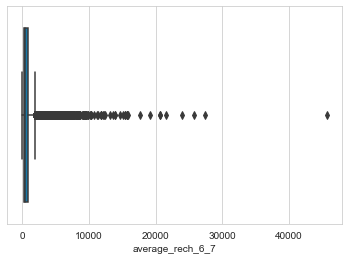

In [86]:
#Boxplot:
#Boxplot to find out the range of average_rech_6_7:
sns.set_style('whitegrid')
plt.figure(figsize = (6,4))
sns.boxplot(x='average_rech_6_7',data=df,palette='winter')

<font size = 5 color = Skyblue> **Filetering high value customers:** </font>    
    <br>

In [87]:
#Filtered HVC by taking rows which are > 70% for 6 & 7 Good phase months.
cdf = df[df['average_rech_6_7'] > df['average_rech_6_7'].quantile(0.7)]
cdf.shape

(30000, 204)

In [88]:
#Taking backup of derived features.
df_bkp = cdf.copy()
#After derived features the shape of df:
df_bkp.shape

(30000, 204)

In [89]:
#After filtering out HVC (>70%) zero'th quantile is: 
df_bkp['average_rech_6_7'].quantile(q=0)

755.4499999999999

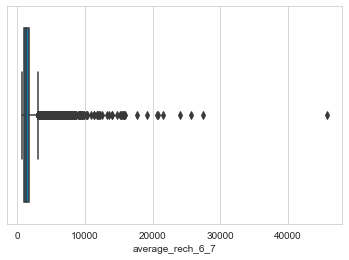

In [90]:
#Boxplot for the HVC after filtering.
sns.set_style('whitegrid')
plt.figure(figsize = (6,4))
sns.boxplot(x='average_rech_6_7',data=df_bkp, palette='winter')

In [91]:
#describing the dataframe
df_bkp.describe()

,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_9,offnet_mou_9,roam_ic_mou_9,roam_og_mou_9,loc_og_t2t_mou_9,loc_og_t2m_mou_9,loc_og_t2f_mou_9,loc_og_t2c_mou_9,loc_og_mou_9,std_og_t2t_mou_9,std_og_t2m_mou_9,std_og_t2f_mou_9,std_og_mou_9,isd_og_mou_9,spl_og_mou_9,og_others_9,total_og_mou_6,total_og_mou_7,total_og_mou_8,total_og_mou_9,loc_ic_t2t_mou_9,loc_ic_t2m_mou_9,loc_ic_t2f_mou_9,loc_ic_mou_9,std_ic_t2t_mou_9,std_ic_t2m_mou_9,std_ic_t2f_mou_9,std_ic_mou_9,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,total_ic_mou_9,spl_ic_mou_9,isd_ic_mou_9,ic_others_9,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_num_9,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,total_rech_amt_9,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,max_rech_amt_9,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,last_day_rch_amt_9,max_rech_data_6,max_rech_data_7,max_rech_data_8,max_rech_data_9,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_2g_9,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,count_rech_3g_9,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_2g_mb_9,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,vol_3g_mb_9,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_3g_9,arpu_2g_6,arpu_2g_7,arpu_2g_8,arpu_2g_9,night_pck_user_6,night_pck_user_7,night_pck_user_8,night_pck_user_9,monthly_2g_6,monthly_2g_7,monthly_2g_8,monthly_2g_9,sachet_2g_6,sachet_2g_7,sachet_2g_8,sachet_2g_9,monthly_3g_6,monthly_3g_7,monthly_3g_8,monthly_3g_9,sachet_3g_6,sachet_3g_7,sachet_3g_8,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,vbc_3g_8,vbc_3g_7,vbc_3g_6,vbc_3g_9,total_rech_data_amt_6,total_rech_data_amt_7,total_rech_data_amt_8,total_rech_data_amt_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_6,total_rech_7,average_rech_6_7
count,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30000.00,30

In [92]:
#filtering out Target phase (9th month features)
df_like_9 = df_bkp[df_bkp.columns[df_bkp.columns.to_series().str.contains('_9')]]
df_like_9.head()

,arpu_9,onnet_mou_9,offnet_mou_9,roam_ic_mou_9,roam_og_mou_9,loc_og_t2t_mou_9,loc_og_t2m_mou_9,loc_og_t2f_mou_9,loc_og_t2c_mou_9,loc_og_mou_9,std_og_t2t_mou_9,std_og_t2m_mou_9,std_og_t2f_mou_9,std_og_mou_9,isd_og_mou_9,spl_og_mou_9,og_others_9,total_og_mou_9,loc_ic_t2t_mou_9,loc_ic_t2m_mou_9,loc_ic_t2f_mou_9,loc_ic_mou_9,std_ic_t2t_mou_9,std_ic_t2m_mou_9,std_ic_t2f_mou_9,std_ic_mou_9,total_ic_mou_9,spl_ic_mou_9,isd_ic_mou_9,ic_others_9,total_rech_num_9,total_rech_amt_9,max_rech_amt_9,date_of_last_rech_9,last_day_rch_amt_9,max_rech_data_9,count_rech_2g_9,count_rech_3g_9,vol_2g_mb_9,vol_3g_mb_9,arpu_3g_9,arpu_2g_9,night_pck_user_9,monthly_2g_9,sachet_2g_9,monthly_3g_9,sachet_3g_9,fb_user_9,vbc_3g_9,total_rech_data_amt_9
6,114.75,15.23,50.33,0.00,0.00,15.23,50.33,0.00,0.00,65.56,0.00,0.00,0.00,0.00,0.00,0.00,0.35,65.91,2334.88,231.41,6.19,2572.49,0.00,0.00,0.00,0.00,2572.49,0.00,0.00,0.00,7,141,30,2014-09-28,24,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0,0,0,0,0.00,0.00,0.00
7,500.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,3,0,0,2014-09-30,0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0,0,0,0,0.00,0.00,0.00
13,322.73,244.81,214.06,136.78,12.78,6.14,108.24,5.29,0.00,119.69,230.38,96.01,0.00,326.39,0.00,0.00,0.00,446.09,24.98,104.79,8.51,138.29,62.39,151.51,0.00,213.91,631.86,0.00,259.33,20.31,7,353,130,2014-09-26,0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0,0,0,0,0.00,0.00,0.00
21,578.60,161.63,869.89,0.00,0.00,29.98,107.54,0.00,0.00,137.53,131.64,762.34,0.00,893.99,0.00,0.00,0.00,1031.53,17.99,113.46,8.41,139.88,16.74,95.98,0.00,112.73,252.61,0.00,0.00,0.00,17,680,50,2014-09-30,30,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0,0,0,0,0.00,0.00,0.00
24,473.03,138.04,481.86,0.00,0.00,31.58,207.18,33.13,4.78,271.89,106.46,222.96,10.01,339.44,0.00,16.43,0.00,627.78,19.51,115.76,132.99,268.28,24.38,18.58,18.78,61.74,330.03,0.00,0.00,0.00,6,421,250,2014-09-29,0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0,0,0,0,0.00,0.00,0.00


In [93]:
df_like_9.columns

Index(['arpu_9', 'onnet_mou_9', 'offnet_mou_9', 'roam_ic_mou_9',
       'roam_og_mou_9', 'loc_og_t2t_mou_9', 'loc_og_t2m_mou_9',
       'loc_og_t2f_mou_9', 'loc_og_t2c_mou_9', 'loc_og_mou_9',
       'std_og_t2t_mou_9', 'std_og_t2m_mou_9', 'std_og_t2f_mou_9',
       'std_og_mou_9', 'isd_og_mou_9', 'spl_og_mou_9', 'og_others_9',
       'total_og_mou_9', 'loc_ic_t2t_mou_9', 'loc_ic_t2m_mou_9',
       'loc_ic_t2f_mou_9', 'loc_ic_mou_9', 'std_ic_t2t_mou_9',
       'std_ic_t2m_mou_9', 'std_ic_t2f_mou_9', 'std_ic_mou_9',
       'total_ic_mou_9', 'spl_ic_mou_9', 'isd_ic_mou_9', 'ic_others_9',
       'total_rech_num_9', 'total_rech_amt_9', 'max_rech_amt_9',
       'date_of_last_rech_9', 'last_day_rch_amt_9', 'max_rech_data_9',
       'count_rech_2g_9', 'count_rech_3g_9', 'vol_2g_mb_9', 'vol_3g_mb_9',
       'arpu_3g_9', 'arpu_2g_9', 'night_pck_user_9', 'monthly_2g_9',
       'sachet_2g_9', 'monthly_3g_9', 'sachet_3g_9', 'fb_user_9', 'vbc_3g_9',
       'total_rech_data_amt_9'],
      dtype='obje

In [94]:
#Shape of target phase:
df_like_9.shape

(30000, 50)

In [95]:
#Total recharge for 9th month calls & data recharges:
df_bkp['total_rech_9'] = df_bkp['total_ic_mou_9'] + df_bkp['total_og_mou_9']+df_bkp['vol_2g_mb_9'] + df_bkp['vol_3g_mb_9'] 

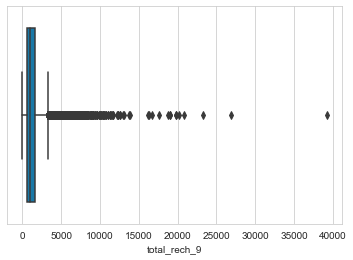

In [96]:
#Boxplot for target phase derived feature:
sns.set_style('whitegrid')
plt.figure(figsize = (6,4))
sns.boxplot(x='total_rech_9',data=df_bkp, palette='winter')

In [97]:
df_bkp.shape

(30000, 205)

<font size = 5 color = Skyblue> **Tag Churners & Remove churnphse attributes:** </font>    
    <br>

In [ ]:
#Deriving churn(Target) feature:
def f(df_bkp):
    if df_bkp['total_rech_9'] == 0:
        val = 1
    else:
        val = 0
    return val

df_bkp['is_churn'] = df_bkp.apply(f, axis=1)
df_bkp.nunique()

In [99]:
print("There are {} users tagged as churners out of {} High-Value Customers.".format(len(df_bkp[df_bkp['is_churn'] == 1]),df_bkp.shape[0]))
print("High-value Churn Percentage : {}%".format(round(len(df_bkp[df_bkp.is_churn == 1])/df_bkp.shape[0] *100,2)))

There are 2313 users tagged as churners out of 30000 High-Value Customers.
High-value Churn Percentage : 7.71%


In [100]:
df_bkp.shape

(30000, 206)

In [101]:
df_bkp.head()

,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_9,offnet_mou_9,roam_ic_mou_9,roam_og_mou_9,loc_og_t2t_mou_9,loc_og_t2m_mou_9,loc_og_t2f_mou_9,loc_og_t2c_mou_9,loc_og_mou_9,std_og_t2t_mou_9,std_og_t2m_mou_9,std_og_t2f_mou_9,std_og_mou_9,isd_og_mou_9,spl_og_mou_9,og_others_9,total_og_mou_6,total_og_mou_7,total_og_mou_8,total_og_mou_9,loc_ic_t2t_mou_9,loc_ic_t2m_mou_9,loc_ic_t2f_mou_9,loc_ic_mou_9,std_ic_t2t_mou_9,std_ic_t2m_mou_9,std_ic_t2f_mou_9,std_ic_mou_9,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,total_ic_mou_9,spl_ic_mou_9,isd_ic_mou_9,ic_others_9,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_num_9,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,total_rech_amt_9,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,max_rech_amt_9,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,date_of_last_rech_9,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,last_day_rch_amt_9,max_rech_data_6,max_rech_data_7,max_rech_data_8,max_rech_data_9,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_2g_9,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,count_rech_3g_9,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_2g_mb_9,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,vol_3g_mb_9,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_3g_9,arpu_2g_6,arpu_2g_7,arpu_2g_8,arpu_2g_9,night_pck_user_6,night_pck_user_7,night_pck_user_8,night_pck_user_9,monthly_2g_6,monthly_2g_7,monthly_2g_8,monthly_2g_9,sachet_2g_6,sachet_2g_7,sachet_2g_8,sachet_2g_9,monthly_3g_6,monthly_3g_7,monthly_3g_8,monthly_3g_9,sachet_3g_6,sachet_3g_7,sachet_3g_8,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,vbc_3g_8,vbc_3g_7,vbc_3g_6,vbc_3g_9,total_rech_data_amt_6,total_rech_data_amt_7,total_rech_data_amt_8,total_rech_data_amt_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_6,total_rech_7,average_rech_6_7,total_rech_9,is_churn
6,429.02,190.70,255.11,114.75,15.23,50.33,0.00,0.00,15.23,50.33,0.00,0.00,65.56,0.00,0.00,0.00,0.00,0.00,0.00,0.35,333.76,94.81,168.74,65.91,2334.88,231.41,6.19,2572.49,0.00,0.00,0.00,0.00,2128.41,1788.06,2167.11,2572.49,0.00,0.00,0.00,15,10,11,7,499,222,294,141,90,37,50,30,2014-06-28,2014-07-31,2014-08-28,2014-09-28,37,24,10,24,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.00,0.00,0.00,0.00,1673,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,71.03,45.03,76.66,262.73,49.24,92.08,0.00,0.00,0.00,0.00,0.00,0.00,71.03,45.03,76.14,252.23,48.71,80.63,10.38,0.00,0.00,0.11,0.00,0.00,333.64,93.74,156.78,0.00,0.00,0.51,0.00,0.53,11.45,0.00,0.00,0.00,0.00,0.53,11.96,0.00,0.00,0.00,0.11,0.53,0.00,0.00,0.00,0.00,1857.99,1427.04,1896.43,248.64,336.96,265.28,20.24,22.69,2.51,2126.89,1786.71,2164.23,0.00,0.00,0.00,1.39,0.76,2.60,0.00,0.00,0.00,1.39,0.76,2.60,0.00,0.00,0.00,0.00,0.00,0

## Data Analysis:

In [102]:
import dexplot as dex
# Graphics in retina format are more sharp and legible
%config InlineBackend.figure_format = 'retina'

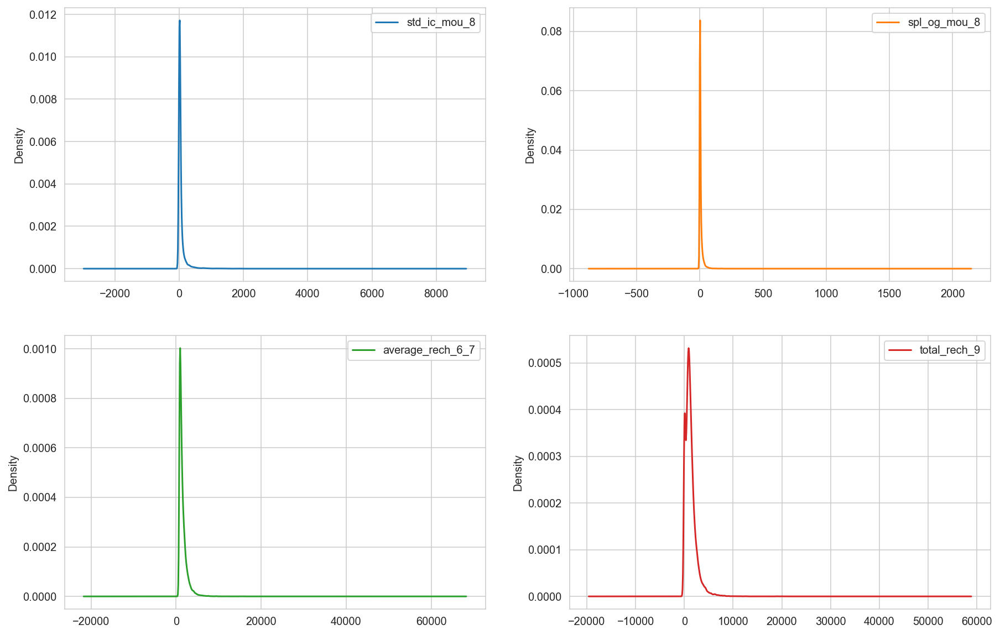

In [103]:
num_features = ['std_ic_mou_8', 'spl_og_mou_8', 'average_rech_6_7', 'total_rech_9']
df_bkp[num_features].plot(kind='density', subplots=True, layout=(2, 2), sharex=False, figsize=(15, 10));

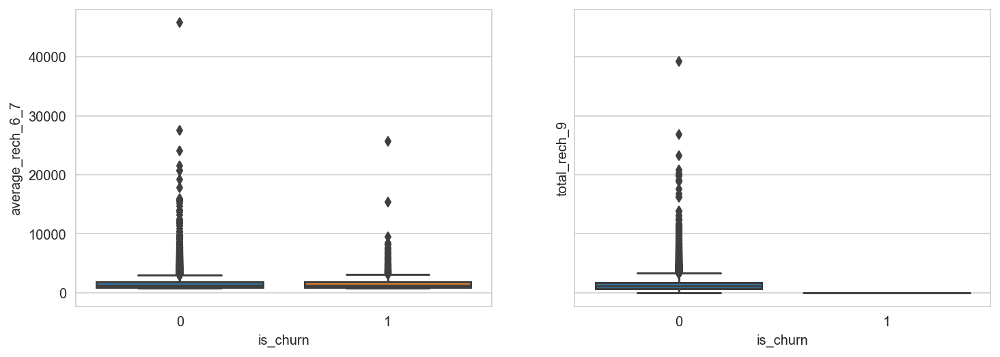

In [104]:
_, axes = plt.subplots(1, 2, sharey=True, figsize=(12, 4))

sns.boxplot(x='is_churn', y='average_rech_6_7', data=df_bkp, ax=axes[0]);
sns.boxplot(x='is_churn', y='total_rech_9', data=df_bkp, ax=axes[1]);

### Inference:
- All the numerical features are right skewed normal distributions. There are no extreme outliers

In [105]:
# Distribution graphs (histogram/bar graph) of column data
def plotPerColumnDistribution(df, nGraphShown, nGraphPerRow):
    nunique = df.nunique()
    df = df[[col for col in df if nunique[col] > 1 and nunique[col] < 50]] # For displaying purposes, pick columns that have between 1 and 50 unique values
    nRow, nCol = df.shape
    columnNames = list(df)
    nGraphRow = (nCol + nGraphPerRow - 1) / nGraphPerRow
    plt.figure(num = None, figsize = (6 * nGraphPerRow, 8 * nGraphRow), dpi = 80, facecolor = 'w', edgecolor = 'k')
    for i in range(min(nCol, nGraphShown)):
        plt.subplot(nGraphRow, nGraphPerRow, i + 1)
        columnDf = df.iloc[:, i]
        if (not np.issubdtype(type(columnDf.iloc[0]), np.number)):
            valueCounts = columnDf.value_counts()
            valueCounts.plot.bar()
        else:
            columnDf.hist()
        plt.ylabel('counts')
        plt.xticks(rotation = 90)
        plt.title(f'{columnNames[i]} (column {i})')
    plt.tight_layout(pad = 1.0, w_pad = 1.0, h_pad = 1.0)
    plt.show()

In [106]:
def plotCorrelationMatrix(df, graphWidth):
    filename = "Telecom Churn"
    df = df.dropna('columns') # drop columns with NaN
    df = df[[col for col in df if df[col].nunique() > 1]] # keep columns where there are more than 1 unique values
    if df.shape[1] < 2:
        print(f'No correlation plots shown: The number of non-NaN or constant columns ({df.shape[1]}) is less than 2')
        return
    corr = df.corr()
    plt.figure(num=None, figsize=(graphWidth, graphWidth), dpi=80, facecolor='w', edgecolor='k')
    corrMat = plt.matshow(corr, fignum = 1)
    plt.xticks(range(len(corr.columns)), corr.columns, rotation=90)
    plt.yticks(range(len(corr.columns)), corr.columns)
    plt.gca().xaxis.tick_bottom()
    plt.colorbar(corrMat)
    plt.title(f'Correlation Matrix for {filename}', fontsize=15)
    plt.show()

In [107]:
# Scatter and density plots
def plotScatterMatrix(df, plotSize, textSize):
    df = df.select_dtypes(include =[np.number]) # keep only numerical columns
    # Remove rows and columns that would lead to df being singular
    df = df.dropna('columns')
    df = df[[col for col in df if df[col].nunique() > 1]] # keep columns where there are more than 1 unique values
    columnNames = list(df)
    if len(columnNames) > 10: # reduce the number of columns for matrix inversion of kernel density plots
        columnNames = columnNames[:10]
    df = df[columnNames]
    ax = pd.plotting.scatter_matrix(df, alpha=0.75, figsize=[plotSize, plotSize], diagonal='kde')
    corrs = df.corr().values
    for i, j in zip(*plt.np.triu_indices_from(ax, k = 1)):
        ax[i, j].annotate('Corr. coef = %.3f' % corrs[i, j], (0.8, 0.2), xycoords='axes fraction', ha='center', va='center', size=textSize)
    plt.suptitle('Scatter and Density Plot')
    plt.show()

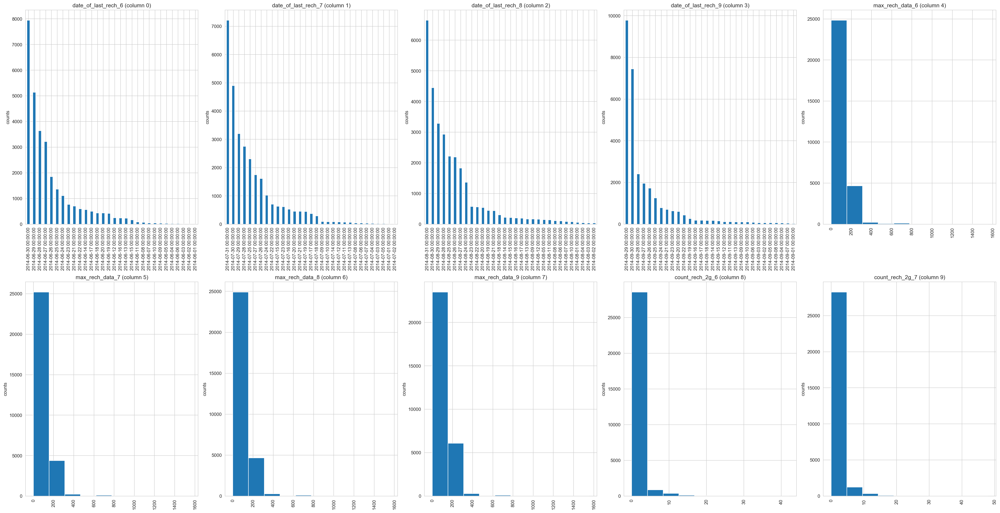

In [108]:
#Distibution Graph for sample cols:
plotPerColumnDistribution(df_bkp, 10, 5)

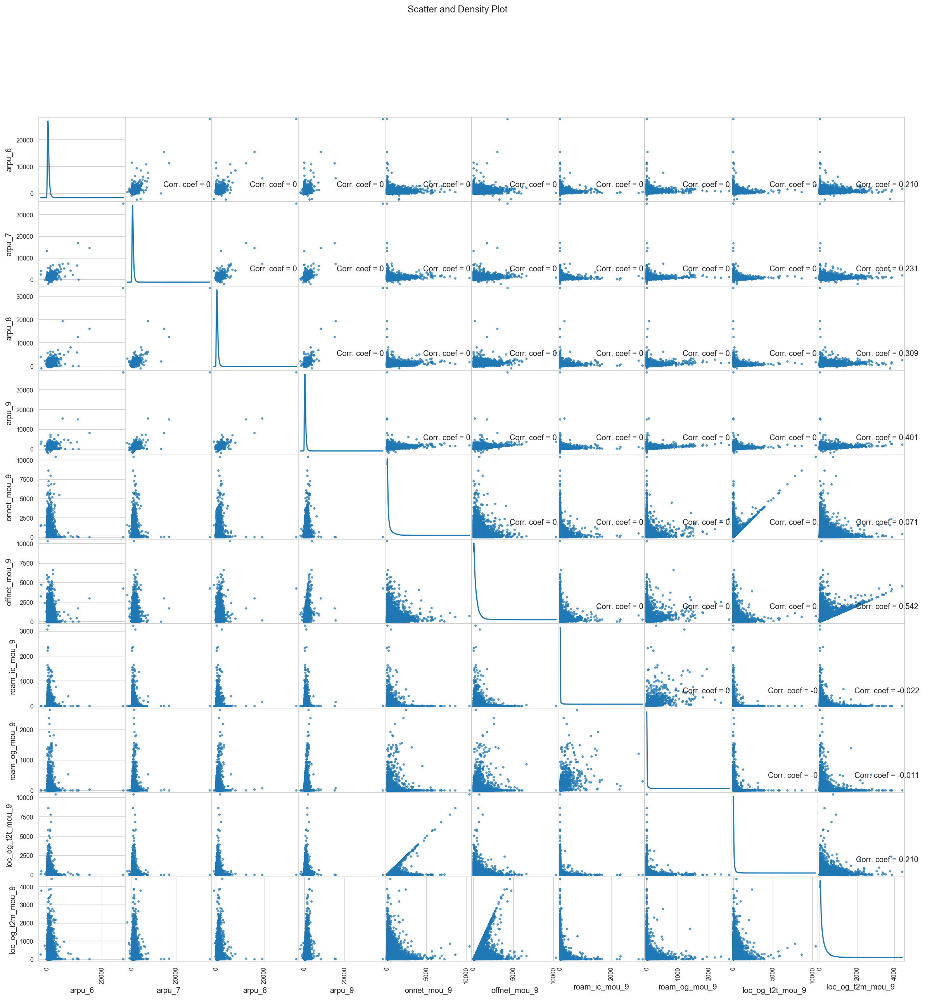

In [110]:
#Scatter Density plots:
plotScatterMatrix(df_bkp, 20, 10)

In [111]:
col_list = df_bkp.filter(regex='_6|_7').columns.str[:-2]
col_list.unique()

Index(['arpu', 'total_og_mou', 'total_ic_mou', 'total_rech_num',
       'total_rech_amt', 'max_rech_amt', 'date_of_last_rech',
       'last_day_rch_amt', 'max_rech_data', 'count_rech_2g', 'count_rech_3g',
       'vol_2g_mb', 'vol_3g_mb', 'arpu_3g', 'arpu_2g', 'night_pck_user',
       'monthly_2g', 'sachet_2g', 'monthly_3g', 'sachet_3g', 'fb_user',
       'vbc_3g', 'total_rech_data_amt', 'onnet_mou', 'offnet_mou',
       'roam_ic_mou', 'roam_og_mou', 'loc_og_t2t_mou', 'loc_og_t2m_mou',
       'loc_og_t2f_mou', 'loc_og_t2c_mou', 'loc_og_mou', 'std_og_t2t_mou',
       'std_og_t2m_mou', 'std_og_t2f_mou', 'std_og_mou', 'isd_og_mou',
       'spl_og_mou', 'og_others', 'loc_ic_t2t_mou', 'loc_ic_t2m_mou',
       'loc_ic_t2f_mou', 'loc_ic_mou', 'std_ic_t2t_mou', 'std_ic_t2m_mou',
       'std_ic_t2f_mou', 'std_ic_mou', 'spl_ic_mou', 'isd_ic_mou', 'ic_others',
       'total_rech', 'average_rech_6'],
      dtype='object')

In [112]:
len(col_list.unique())

52

In [113]:
print(df_bkp.shape)

(30000, 206)


Text(0.5, 1.0, 'Churn Distribution')

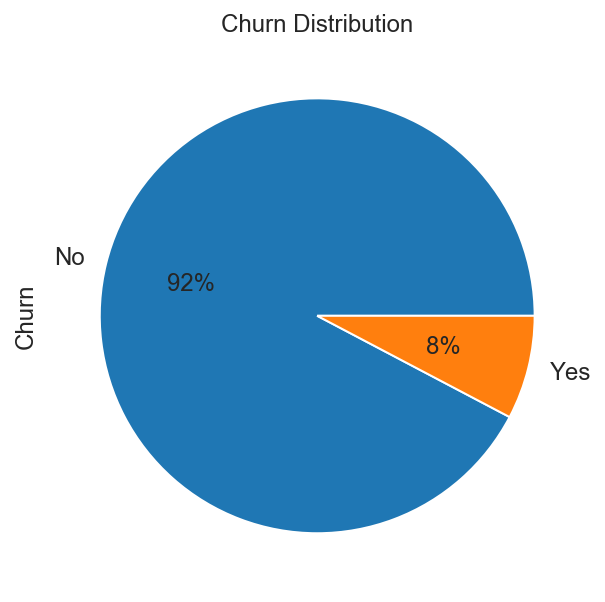

In [114]:
#Churn Distribution
ax = (df_bkp['is_churn'].value_counts()*100.0 /len(df_bkp)).plot.pie(autopct='%.0f%%', labels = ['No', 'Yes'],figsize =(5,5), fontsize = 12 )                                                                           

ax.set_ylabel('Churn',fontsize = 12)
ax.set_title('Churn Distribution', fontsize = 12)

<font color= blue size=5> Inference:</font>
- **Feature is_churn distribution:**

- Around 92% of the customers are Unchurn & rest 8% are churn.
- Clearly the data is skewed as we would expect a large majority of the customers to 'unchurn'. 
- In modelling due to skeweness it can lead us a lot of false negatives.Need to tackle this.

In [115]:
#Create Derived categorical variable
df_bkp['aon_bin'] = pd.cut(df_bkp['aon'], range(0,df_bkp['aon'].max(),365), labels=range(0,int(round(df_bkp['aon'].max()/365))-1))

### Incoming VS month VS AON¶


Text(0.5, 1.0, 'Customers by their tenure')

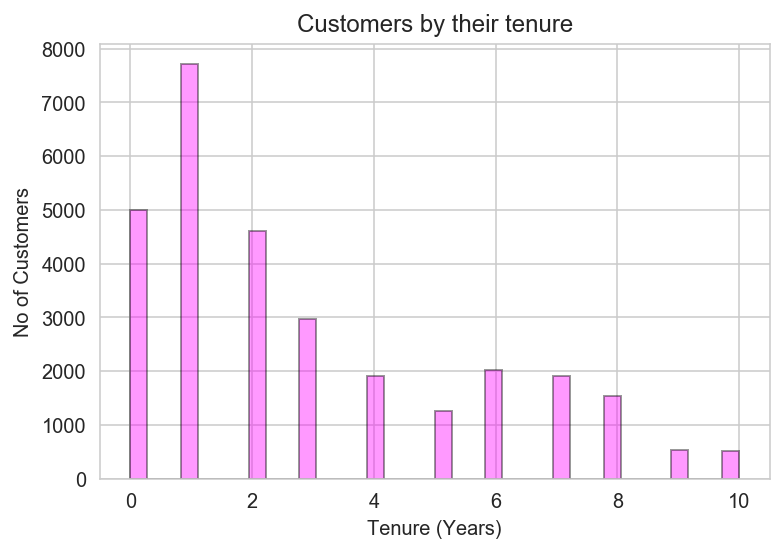

In [116]:
ax = sns.distplot(df_bkp['aon_bin'], hist=True, kde=False, 
             bins=int(180/5), color = 'magenta', 
             hist_kws={'edgecolor':'black'},
             kde_kws={'linewidth': 4})
ax.set_ylabel('No of Customers')
ax.set_xlabel('Tenure (Years)')
ax.set_title('Customers by their tenure')

In [117]:
#Conevrt AON in Months
df_bkp['aon_mon'] = df_bkp['aon']/30
df_bkp.drop('aon', axis=1, inplace=True)
df_bkp['aon_mon'].head()

6     55.77
7     26.73
13    86.90
21    24.00
24   102.40
Name: aon_mon, dtype: float64

In [118]:
tn_range = [0, 6, 12, 24, 60, 61]
tn_label = [ '0-6 Months', '6-12 Months', '1-2 Yrs', '2-5 Yrs', '5 Yrs and above']
df_bkp['tenure_range'] = pd.cut(df_bkp['aon_mon'], tn_range, labels=tn_label)
df_bkp['tenure_range'].head()

6     2-5 Yrs
7     2-5 Yrs
13        NaN
21    1-2 Yrs
24        NaN
Name: tenure_range, dtype: category
Categories (5, object): [0-6 Months < 6-12 Months < 1-2 Yrs < 2-5 Yrs < 5 Yrs and above]

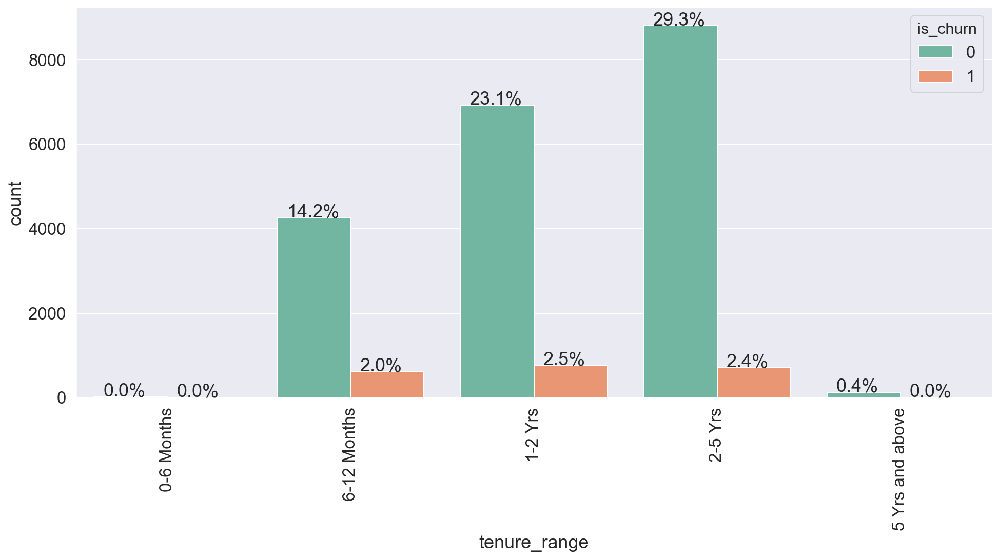

In [119]:
# count plot for the customers as per the age of utilisation of the network services
sns.set()
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 2.5})

temp = pd.Series(data = 'tenure_range')
fig, ax = plt.subplots()
width = len(df_bkp['tenure_range'].unique()) + 6 + 4*len(temp.unique())
fig.set_size_inches(width , 7)

total = float(len(df_bkp.index))
ax = sns.countplot(x="tenure_range", data=df_bkp, palette="Set2", hue = "is_churn");
for p in ax.patches:
                ax.annotate('{:1.1f}%'.format((p.get_height()*100)/float(len(df_bkp))), (p.get_x()+0.05, p.get_height()+20))
plt.xticks(rotation=90)
plt.show()

In [120]:
#Dropping target feature realted columns from main df:
df_bkp = df_bkp.drop(['arpu_9', 'onnet_mou_9', 'offnet_mou_9', 'roam_ic_mou_9',
       'roam_og_mou_9', 'loc_og_t2t_mou_9', 'loc_og_t2m_mou_9',
       'loc_og_t2f_mou_9', 'loc_og_t2c_mou_9', 'loc_og_mou_9',
       'std_og_t2t_mou_9', 'std_og_t2m_mou_9', 'std_og_t2f_mou_9',
       'std_og_mou_9', 'isd_og_mou_9', 'spl_og_mou_9', 'og_others_9',
       'total_og_mou_9', 'loc_ic_t2t_mou_9', 'loc_ic_t2m_mou_9',
       'loc_ic_t2f_mou_9', 'loc_ic_mou_9', 'std_ic_t2t_mou_9',
       'std_ic_t2m_mou_9', 'std_ic_t2f_mou_9', 'std_ic_mou_9',
       'total_ic_mou_9', 'spl_ic_mou_9', 'isd_ic_mou_9', 'ic_others_9',
       'total_rech_num_9', 'total_rech_amt_9', 'max_rech_amt_9',
       'date_of_last_rech_9', 'last_day_rch_amt_9', 'max_rech_data_9',
       'count_rech_2g_9', 'count_rech_3g_9', 'vol_2g_mb_9', 'vol_3g_mb_9',
       'arpu_3g_9', 'arpu_2g_9', 'night_pck_user_9', 'monthly_2g_9',
       'sachet_2g_9', 'monthly_3g_9', 'sachet_3g_9', 'fb_user_9', 'vbc_3g_9',
       'total_rech_data_amt_9','total_rech_9'],axis = 1)

In [121]:
#correlation b/w target feature & rest of the columns:
corr = df_bkp.corr()

<font size = 5 color = Skyblue> **Analysing target variable:** </font>    
    <br>

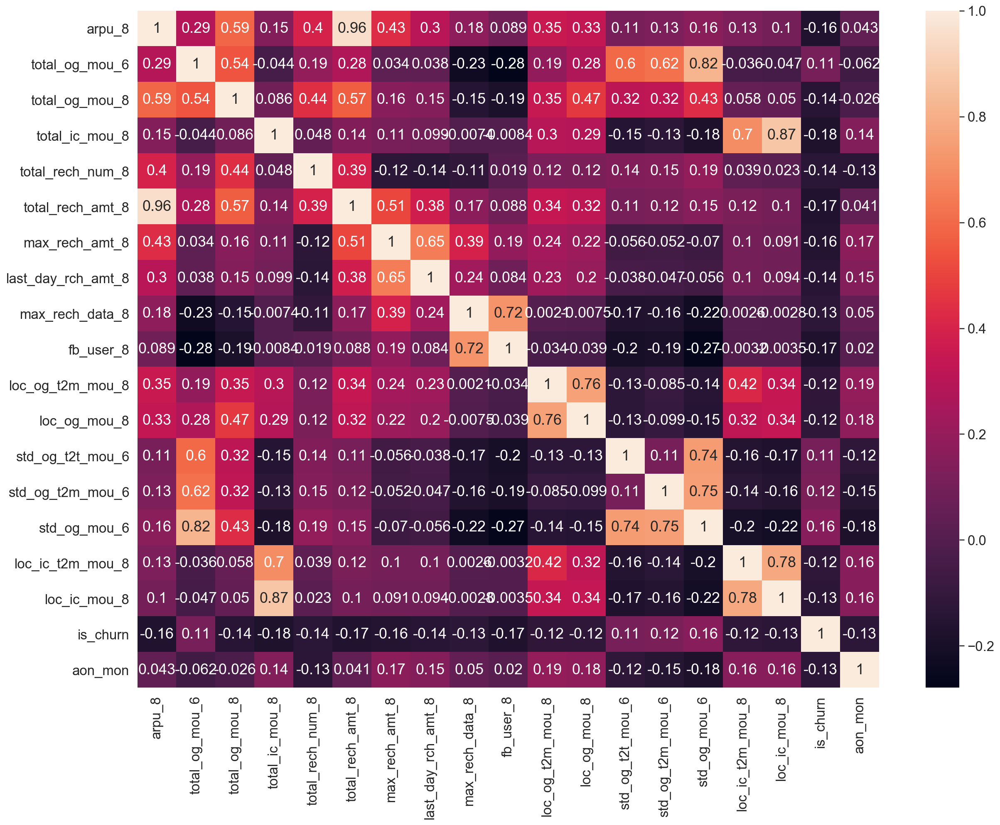

In [122]:
#Correlation w.r.to Target Feature:
top_corr_features = corr.index[abs(corr["is_churn"])>0.1]
plt.figure(figsize=(20,15))
g = sns.heatmap(df_bkp[top_corr_features].corr(),annot=True)

In [123]:
#correlation with the target variable
corr = df_bkp.corr()
print(corr['is_churn'].sort_values(ascending=False))

is_churn                 1.00
std_og_mou_6             0.16
std_og_t2m_mou_6         0.12
std_og_t2t_mou_6         0.11
total_og_mou_6           0.11
onnet_mou_6              0.08
offnet_mou_6             0.08
std_og_mou_7             0.08
total_rech_num_6         0.08
arpu_6                   0.06
std_og_t2m_mou_7         0.06
total_rech_amt_6         0.06
std_og_t2t_mou_7         0.05
roam_og_mou_8            0.05
roam_og_mou_7            0.05
total_rech_6             0.05
roam_ic_mou_8            0.04
roam_ic_mou_7            0.03
spl_og_mou_6             0.02
std_ic_mou_6             0.02
std_ic_t2t_mou_6         0.02
onnet_mou_7              0.02
std_ic_t2m_mou_6         0.02
roam_og_mou_6            0.02
offnet_mou_7             0.02
total_og_mou_7           0.01
og_others_6              0.01
night_pck_user_6         0.01
sachet_3g_6              0.01
count_rech_3g_6          0.01
isd_og_mou_6             0.01
spl_og_mou_7             0.01
isd_og_mou_7             0.01
og_others_

In [124]:
top_corr_features

Index(['arpu_8', 'total_og_mou_6', 'total_og_mou_8', 'total_ic_mou_8',
       'total_rech_num_8', 'total_rech_amt_8', 'max_rech_amt_8',
       'last_day_rch_amt_8', 'max_rech_data_8', 'fb_user_8',
       'loc_og_t2m_mou_8', 'loc_og_mou_8', 'std_og_t2t_mou_6',
       'std_og_t2m_mou_6', 'std_og_mou_6', 'loc_ic_t2m_mou_8', 'loc_ic_mou_8',
       'is_churn', 'aon_mon'],
      dtype='object')

<font color= blue size=5> Inference:</font>
- **Top correlation features w.r.to is_churn feature:**
    'arpu_8', 'total_og_mou_6', 'total_og_mou_8', 'total_ic_mou_8','total_rech_num_8', 'total_rech_amt_8', 'max_rech_amt_8', 'last_day_rch_amt_8', 'max_rech_data_8', 'fb_user_8','loc_og_t2m_mou_8', 'loc_og_mou_8', 'std_og_t2t_mou_6','std_og_t2m_mou_6', 'std_og_mou_6', 'loc_ic_t2m_mou_8', 'loc_ic_mou_8', 'is_churn', 'aon_mon'

In [125]:
df_bkp['is_churn'].head()

6     0
7     1
13    0
21    0
24    0
Name: is_churn, dtype: int64

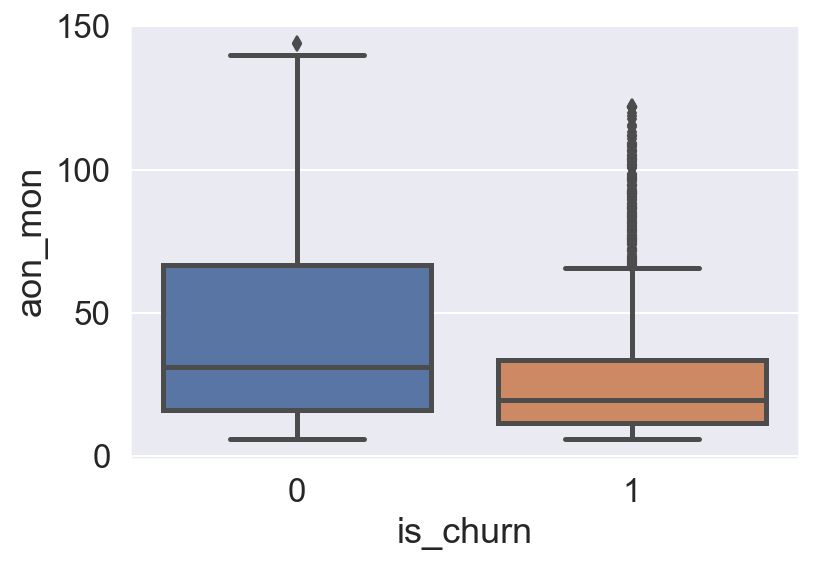

In [126]:
#Boxplot of churn vs aon_mon
sns.boxplot(x = df_bkp.is_churn, y = df_bkp.aon_mon)

<font color= blue size=5> Inference:</font>
- **We can depict the customers who wont churn, will stay for a longer tenure with the telecom company**

In [127]:
#### Outliers Identificatiomn and treatment
len(['arpu_8', 'total_og_mou_6', 'total_og_mou_8', 'total_ic_mou_8',
       'total_rech_num_8', 'total_rech_amt_8', 'max_rech_amt_8',
       'last_day_rch_amt_8', 'max_rech_data_8', 'fb_user_8',
       'loc_og_t2m_mou_8', 'loc_og_mou_8', 'std_og_t2t_mou_6',
       'std_og_t2m_mou_6', 'std_og_mou_6', 'loc_ic_t2m_mou_8', 'loc_ic_mou_8',
       'is_churn', 'aon_mon'])

19

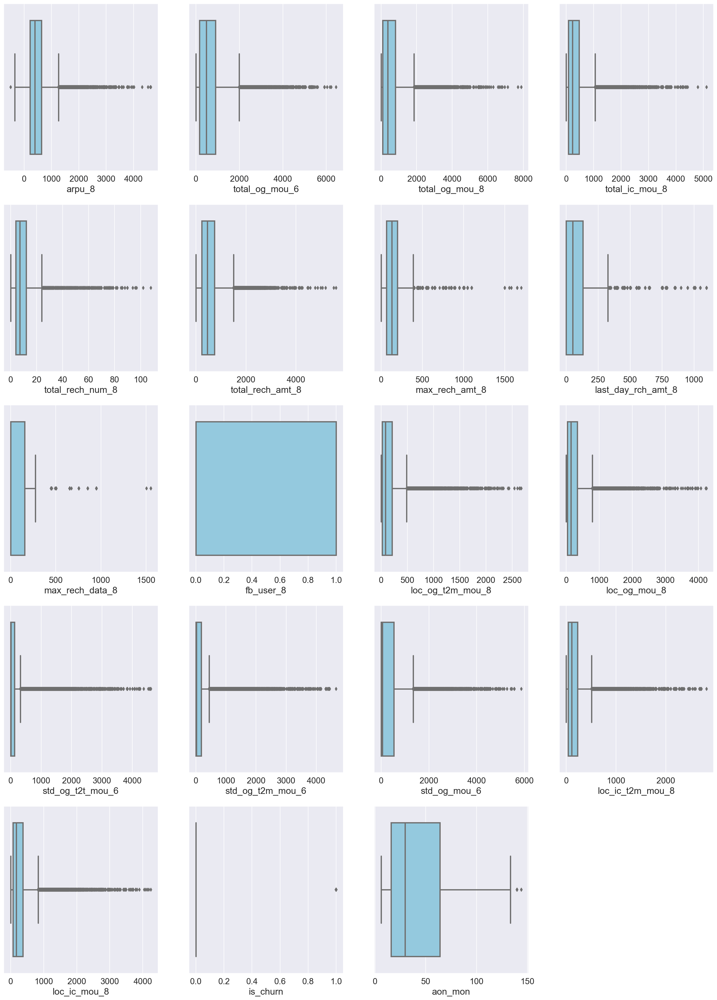

In [168]:
#Looping through columns for outliers using Boxplot's:
fig, axs = plt.subplots( figsize = (25,35))
columns = ['arpu_8', 'total_og_mou_6', 'total_og_mou_8', 'total_ic_mou_8',
       'total_rech_num_8', 'total_rech_amt_8', 'max_rech_amt_8',
       'last_day_rch_amt_8', 'max_rech_data_8', 'fb_user_8',
       'loc_og_t2m_mou_8', 'loc_og_mou_8', 'std_og_t2t_mou_6',
       'std_og_t2m_mou_6', 'std_og_mou_6', 'loc_ic_t2m_mou_8', 'loc_ic_mou_8',
       'is_churn', 'aon_mon']

    
for col in enumerate(columns):
        plt.subplot(5,4,col[0]+1)
        sns.boxplot(x=col[1],data = df_bkp, color="skyblue")

Text(0.5, 1.0, 'Distribution of Volume based cost by churn')

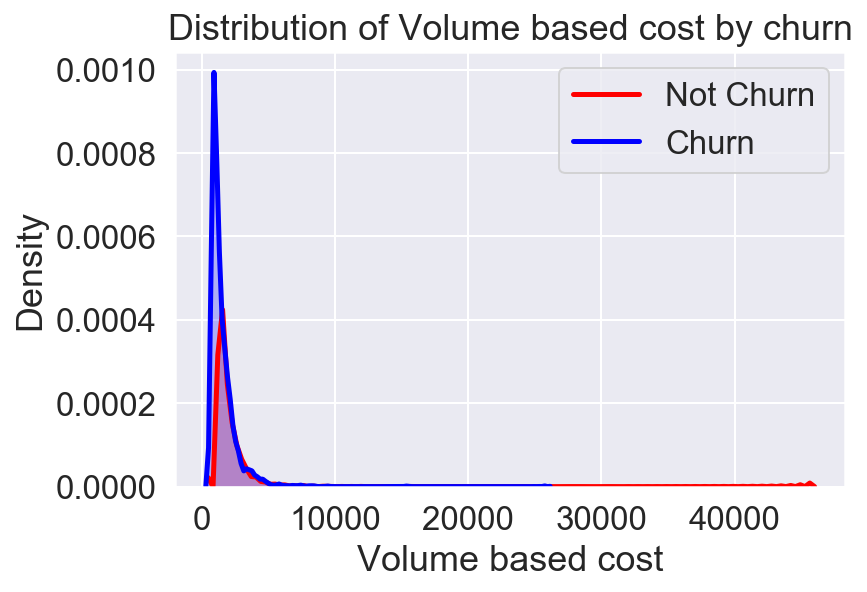

In [129]:
ax = sns.kdeplot(df_bkp.average_rech_6_7[(df_bkp["is_churn"] == 0)],
                color="Red", shade = True)
ax = sns.kdeplot(df_bkp.average_rech_6_7[(df_bkp["is_churn"] == 1)],
                ax =ax, color="Blue", shade= True)
ax.legend(["Not Churn","Churn"],loc='upper right')
ax.set_ylabel('Density')
ax.set_xlabel('Volume based cost')
ax.set_title('Distribution of Volume based cost by churn')

Text(0.5, 1.0, 'Distribution of Max Recharge Amount by churn')

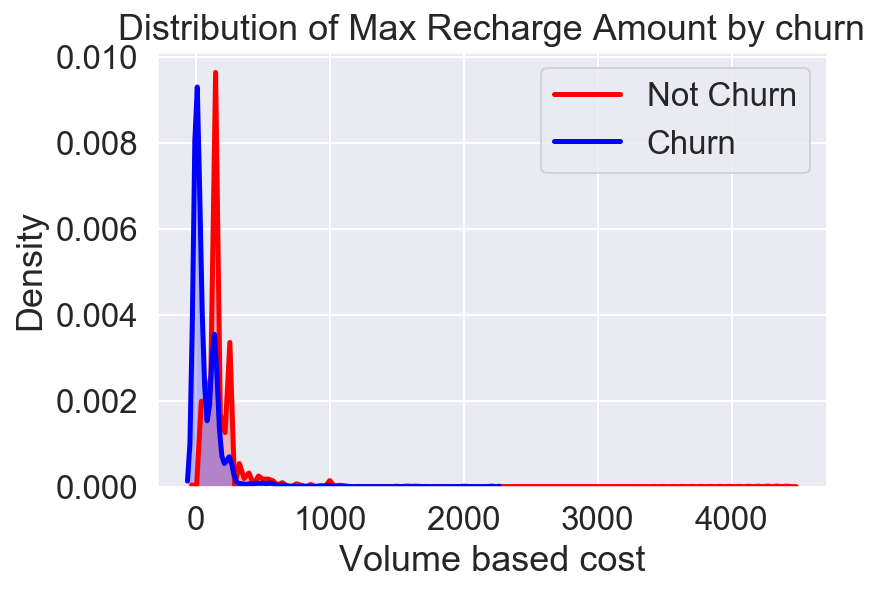

In [130]:
ax = sns.kdeplot(df_bkp.max_rech_amt_8[(df_bkp["is_churn"] == 0)],
                color="Red", shade = True)
ax = sns.kdeplot(df_bkp.max_rech_amt_8[(df_bkp["is_churn"] == 1)],
                ax =ax, color="Blue", shade= True)
ax.legend(["Not Churn","Churn"],loc='upper right')
ax.set_ylabel('Density')
ax.set_xlabel('Volume based cost')
ax.set_title('Distribution of Max Recharge Amount by churn')

<font color = Blue size = 5> Inference: </font>
- **Clear Indication of people recharged less amount are more likely to Churn**
- **No Significant difference in Volume Based Cost & Churn**

<font size = 5 color = Skyblue> **Outlier treatment** </font>    
    <br>

In [131]:
  
# Removing (statistical) outliers from is_Churn highly correlated features
Q1 = df_bkp['arpu_8'].quantile(0.01)
Q3 = df_bkp['arpu_8'].quantile(0.99)
IQR = Q3 - Q1
df_bkp= df_bkp[(df_bkp['arpu_8'] >= Q1 - 1.5*IQR) & (df_bkp['arpu_8'] <= Q3 + 1.5*IQR)]


Q1 = df_bkp['total_og_mou_8'].quantile(0.01)
Q3 = df_bkp['total_og_mou_8'].quantile(0.99)
IQR = Q3 - Q1
df_bkp= df_bkp[(df_bkp['total_og_mou_8'] >= Q1 - 1.5*IQR) & (df_bkp['total_og_mou_8'] <= Q3 + 1.5*IQR)]




Q1 = df_bkp['total_ic_mou_8'].quantile(0.01)
Q3 = df_bkp['total_ic_mou_8'].quantile(0.99)
IQR = Q3 - Q1
df_bkp= df_bkp[(df_bkp['total_ic_mou_8'] >= Q1 - 1.5*IQR) & (df_bkp['total_ic_mou_8'] <= Q3 + 1.5*IQR)]



Q1 = df_bkp['total_rech_num_8'].quantile(0.01)
Q3 = df_bkp['total_rech_num_8'].quantile(0.99)
IQR = Q3 - Q1
df_bkp= df_bkp[(df_bkp['total_rech_num_8'] >= Q1 - 1.5*IQR) & (df_bkp['total_rech_num_8'] <= Q3 + 1.5*IQR)]




Q1 = df_bkp['total_rech_amt_8'].quantile(0.01)
Q3 = df_bkp['total_rech_amt_8'].quantile(0.99)
IQR = Q3 - Q1
df_bkp= df_bkp[(df_bkp['total_rech_amt_8'] >= Q1 - 1.5*IQR) & (df_bkp['total_rech_amt_8'] <= Q3 + 1.5*IQR)]


Q1 = df_bkp['max_rech_amt_8'].quantile(0.01)
Q3 = df_bkp['max_rech_amt_8'].quantile(0.99)
IQR = Q3 - Q1
df_bkp= df_bkp[(df_bkp['max_rech_amt_8'] >= Q1 - 1.5*IQR) & (df_bkp['max_rech_amt_8'] <= Q3 + 1.5*IQR)]





Q1 = df_bkp['std_og_mou_6'].quantile(0.01)
Q3 = df_bkp['std_og_mou_6'].quantile(0.99)
IQR = Q3 - Q1
df_bkp= df_bkp[(df_bkp['std_og_mou_6'] >= Q1 - 1.5*IQR) & (df_bkp['std_og_mou_6'] <= Q3 + 1.5*IQR)]




Q1 = df_bkp['last_day_rch_amt_8'].quantile(0.01)
Q3 = df_bkp['last_day_rch_amt_8'].quantile(0.99)
IQR = Q3 - Q1
df_bkp= df_bkp[(df_bkp['last_day_rch_amt_8'] >= Q1 - 1.5*IQR) & (df_bkp['last_day_rch_amt_8'] <= Q3 + 1.5*IQR)]



Q1 = df_bkp['total_og_mou_8'].quantile(0.01)
Q3 = df_bkp['total_og_mou_8'].quantile(0.99)
IQR = Q3 - Q1
df_bkp= df_bkp[(df_bkp['total_og_mou_8'] >= Q1 - 1.5*IQR) & (df_bkp['total_og_mou_8'] <= Q3 + 1.5*IQR)]

In [132]:
# Removing (statistical) outliers from is_Churn highly correlated rest of the features

Q1 = df_bkp['fb_user_8'].quantile(0.01)
Q3 = df_bkp['fb_user_8'].quantile(0.99)
IQR = Q3 - Q1
df_bkp= df_bkp[(df_bkp['fb_user_8'] >= Q1 - 1.5*IQR) & (df_bkp['fb_user_8'] <= Q3 + 1.5*IQR)]


Q1 = df_bkp['loc_og_t2m_mou_8'].quantile(0.01)
Q3 = df_bkp['loc_og_t2m_mou_8'].quantile(0.99)
IQR = Q3 - Q1
df_bkp= df_bkp[(df_bkp['loc_og_t2m_mou_8'] >= Q1 - 1.5*IQR) & (df_bkp['loc_og_t2m_mou_8'] <= Q3 + 1.5*IQR)]




Q1 = df_bkp['loc_og_mou_8'].quantile(0.01)
Q3 = df_bkp['loc_og_mou_8'].quantile(0.99)
IQR = Q3 - Q1
df_bkp= df_bkp[(df_bkp['loc_og_mou_8'] >= Q1 - 1.5*IQR) & (df_bkp['loc_og_mou_8'] <= Q3 + 1.5*IQR)]



Q1 = df_bkp['std_og_t2t_mou_6'].quantile(0.01)
Q3 = df_bkp['std_og_t2t_mou_6'].quantile(0.99)
IQR = Q3 - Q1
df_bkp= df_bkp[(df_bkp['std_og_t2t_mou_6'] >= Q1 - 1.5*IQR) & (df_bkp['std_og_t2t_mou_6'] <= Q3 + 1.5*IQR)]





Q1 = df_bkp['std_og_t2m_mou_6'].quantile(0.01)
Q3 = df_bkp['std_og_t2m_mou_6'].quantile(0.99)
IQR = Q3 - Q1
df_bkp= df_bkp[(df_bkp['std_og_t2m_mou_6'] >= Q1 - 1.5*IQR) & (df_bkp['std_og_t2m_mou_6'] <= Q3 + 1.5*IQR)]


Q1 = df_bkp['loc_ic_t2m_mou_8'].quantile(0.01)
Q3 = df_bkp['loc_ic_t2m_mou_8'].quantile(0.99)
IQR = Q3 - Q1
df_bkp= df_bkp[(df_bkp['loc_ic_t2m_mou_8'] >= Q1 - 1.5*IQR) & (df_bkp['loc_ic_t2m_mou_8'] <= Q3 + 1.5*IQR)]




Q1 = df_bkp['loc_ic_mou_8'].quantile(0.01)
Q3 = df_bkp['loc_ic_mou_8'].quantile(0.99)
IQR = Q3 - Q1
df_bkp= df_bkp[(df_bkp['loc_ic_mou_8'] >= Q1 - 1.5*IQR) & (df_bkp['loc_ic_mou_8'] <= Q3 + 1.5*IQR)]



Q1 = df_bkp['aon_mon'].quantile(0.01)
Q3 = df_bkp['aon_mon'].quantile(0.99)
IQR = Q3 - Q1
df_bkp= df_bkp[(df_bkp['aon_mon'] >= Q1 - 1.5*IQR) & (df_bkp['aon_mon'] <= Q3 + 1.5*IQR)]


Q1 = df_bkp['is_churn'].quantile(0.01)
Q3 = df_bkp['is_churn'].quantile(0.99)
IQR = Q3 - Q1
df_bkp= df_bkp[(df_bkp['is_churn'] >= Q1 - 1.5*IQR) & (df_bkp['is_churn'] <= Q3 + 1.5*IQR)]


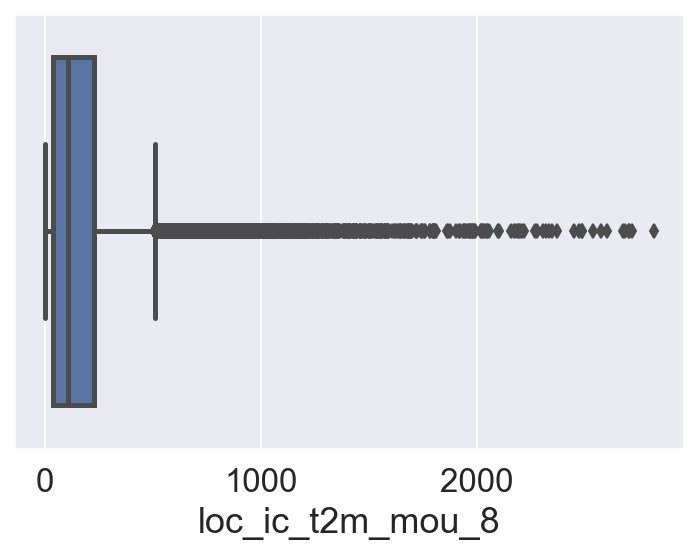

In [133]:
 #Boxplot to check outlier's:
sns.boxplot(df_bkp['loc_ic_t2m_mou_8'])

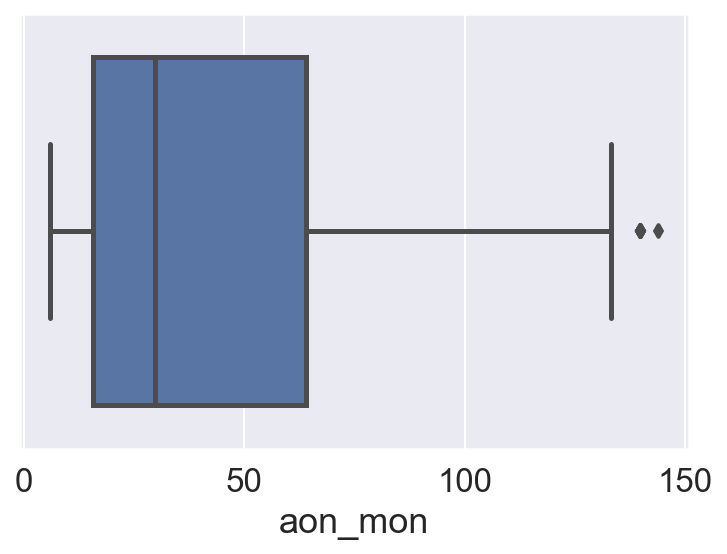

In [134]:
 #Boxplot to check outlier's:
sns.boxplot(df_bkp['aon_mon'])

In [135]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99999 entries, 0 to 99998
Columns: 204 entries, arpu_6 to average_rech_6_7
dtypes: datetime64[ns](4), float64(167), int64(33)
memory usage: 155.6 MB


In [136]:
df_bkp.select_dtypes( ['datetime64']).columns

Index(['date_of_last_rech_6', 'date_of_last_rech_7', 'date_of_last_rech_8'], dtype='object')

In [137]:
#dropping timestamp cols:
drop_col = ["date_of_last_rech_6", "date_of_last_rech_7", "date_of_last_rech_8"]
df_bkp.drop(drop_col, axis=1, inplace=True)

In [138]:
df_bkp.drop(['tenure_range'],axis=1,inplace=True)


In [139]:
df_bkp.drop(['aon_bin'],axis=1,inplace=True)

In [140]:
# Checking the shape of the dataframe again
df_bkp.shape

(29883, 152)

In [141]:
#checking if the columns have any null values
df_bkp.isnull().any(axis=0) 

arpu_6                   False
arpu_7                   False
arpu_8                   False
total_og_mou_6           False
total_og_mou_7           False
total_og_mou_8           False
total_ic_mou_6           False
total_ic_mou_7           False
total_ic_mou_8           False
total_rech_num_6         False
total_rech_num_7         False
total_rech_num_8         False
total_rech_amt_6         False
total_rech_amt_7         False
total_rech_amt_8         False
max_rech_amt_6           False
max_rech_amt_7           False
max_rech_amt_8           False
last_day_rch_amt_6       False
last_day_rch_amt_7       False
last_day_rch_amt_8       False
max_rech_data_6          False
max_rech_data_7          False
max_rech_data_8          False
count_rech_2g_6          False
count_rech_2g_7          False
count_rech_2g_8          False
count_rech_3g_6          False
count_rech_3g_7          False
count_rech_3g_8          False
vol_2g_mb_6              False
vol_2g_mb_7              False
vol_2g_m

In [142]:
# Calculating percentage of data lost because of outlier treatment
((len(df_bkp)-df_bkp.shape[0])/len(df_bkp))*100

0.0

In [143]:
#Divide the data into train & test.
X = df_bkp.drop(['is_churn'],axis=1)
y = df_bkp.is_churn

In [144]:
X.shape

(29883, 151)

In [145]:
#Train-Test Split
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test = train_test_split(X,y,train_size = 0.7, random_state= 93)

In [146]:
#Scaling the data:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.fit_transform(X_test)

In [147]:
#Class Imbalance check
y_train.value_counts(normalize=True)

0   0.92
1   0.08
Name: is_churn, dtype: float64

In [148]:
#Correcting the imbalance ratio
from imblearn import under_sampling 
from imblearn import over_sampling
from imblearn.over_sampling import SMOTE

sm = SMOTE(random_state=100)


X_train_res, y_train_res = sm.fit_sample(X_train, y_train)

In [149]:
y_train_res.value_counts(normalize=True)


1   0.50
0   0.50
Name: is_churn, dtype: float64

<font size = 5 color = skyblue> **Modelling:** </font>    
    <br>


## Logistic Regression: for base line

In [150]:
from sklearn.linear_model import LogisticRegression
from sklearn import metrics


lr=LogisticRegression()
lr.fit(X_train_res,y_train_res)


y_pred = lr.predict(X_test)
print("Accuracy: {}".format(metrics.accuracy_score(y_test,y_pred)))
print("Sensitivity/Recall: {}".format(metrics.recall_score(y_test,y_pred)))

Accuracy: 0.8619074177356386
Sensitivity/Recall: 0.7656716417910447


In [151]:
#Feature Selection Using RFE¶
from sklearn.feature_selection import RFE

rfe = RFE(lr, 20)             
rfe = rfe.fit(X_train, y_train)

In [152]:
type(X_train)

numpy.ndarray

In [153]:
list(zip(X.columns, rfe.support_, rfe.ranking_))

[('arpu_6', False, 43),
 ('arpu_7', False, 33),
 ('arpu_8', True, 1),
 ('total_og_mou_6', False, 106),
 ('total_og_mou_7', False, 122),
 ('total_og_mou_8', True, 1),
 ('total_ic_mou_6', False, 93),
 ('total_ic_mou_7', True, 1),
 ('total_ic_mou_8', True, 1),
 ('total_rech_num_6', False, 60),
 ('total_rech_num_7', True, 1),
 ('total_rech_num_8', True, 1),
 ('total_rech_amt_6', False, 94),
 ('total_rech_amt_7', False, 44),
 ('total_rech_amt_8', False, 45),
 ('max_rech_amt_6', False, 46),
 ('max_rech_amt_7', False, 53),
 ('max_rech_amt_8', False, 91),
 ('last_day_rch_amt_6', False, 86),
 ('last_day_rch_amt_7', False, 51),
 ('last_day_rch_amt_8', True, 1),
 ('max_rech_data_6', False, 101),
 ('max_rech_data_7', False, 99),
 ('max_rech_data_8', False, 13),
 ('count_rech_2g_6', False, 130),
 ('count_rech_2g_7', False, 116),
 ('count_rech_2g_8', False, 15),
 ('count_rech_3g_6', False, 62),
 ('count_rech_3g_7', False, 83),
 ('count_rech_3g_8', False, 21),
 ('vol_2g_mb_6', False, 24),
 ('vol_2g_m

In [154]:
X.columns

Index(['arpu_6', 'arpu_7', 'arpu_8', 'total_og_mou_6', 'total_og_mou_7',
       'total_og_mou_8', 'total_ic_mou_6', 'total_ic_mou_7', 'total_ic_mou_8',
       'total_rech_num_6',
       ...
       'isd_ic_mou_6', 'isd_ic_mou_7', 'isd_ic_mou_8', 'ic_others_6',
       'ic_others_7', 'ic_others_8', 'total_rech_6', 'total_rech_7',
       'average_rech_6_7', 'aon_mon'],
      dtype='object', length=151)

In [293]:
#Printing Top-20 features from Logistic Regression Model for base understanding of key KPI's:
col = X.columns[rfe.support_]
l = list(col)
print(*l,sep='\n')

arpu_7
total_og_mou_8
total_ic_mou_8
last_day_rch_amt_8
vol_2g_mb_8
vol_3g_mb_6
vol_3g_mb_8
arpu_2g_8
fb_user_8
onnet_mou_8
loc_og_t2t_mou_8
loc_og_t2m_mou_8
std_og_t2t_mou_8
std_og_t2m_mou_8
std_og_mou_8
loc_ic_t2t_mou_8
loc_ic_t2m_mou_8
std_ic_mou_8
isd_ic_mou_8
average_rech_6_7


## Inference:

Top Important features are: arpu_7,
total_og_mou_8,
total_ic_mou_8,
last_day_rch_amt_8,
vol_2g_mb_8,
vol_3g_mb_6,
vol_3g_mb_8,
arpu_2g_8,
fb_user_8,
onnet_mou_8,
loc_og_t2t_mou_8,
loc_og_t2m_mou_8,
std_og_t2t_mou_8,
std_og_t2m_mou_8,
std_og_mou_8,
loc_ic_t2t_mou_8,
loc_ic_t2m_mou_8,
std_ic_mou_8,
isd_ic_mou_8,
average_rech_6_7,

## PCA

In [294]:
from sklearn.decomposition import PCA
pca = PCA(svd_solver='randomized', random_state=42)

In [295]:
pca.fit(X_train_res)


PCA(random_state=42, svd_solver='randomized')

In [296]:
pca.explained_variance_ratio_[:50]

array([0.10956444, 0.092748  , 0.06835018, 0.04297604, 0.03825517,
       0.03623124, 0.03537108, 0.02781295, 0.02624965, 0.02406171,
       0.02255602, 0.01984492, 0.01913392, 0.01787434, 0.01773337,
       0.01650745, 0.01563575, 0.01526767, 0.01282778, 0.01204834,
       0.01171471, 0.01090433, 0.01021134, 0.00989672, 0.00964496,
       0.00959346, 0.00952149, 0.00919045, 0.00808249, 0.0077973 ,
       0.00768867, 0.00753972, 0.00737624, 0.00701249, 0.00688007,
       0.00681623, 0.00662153, 0.00626706, 0.00619848, 0.00577327,
       0.00562825, 0.00555375, 0.00535354, 0.00500929, 0.00485507,
       0.00482623, 0.0045939 , 0.00448399, 0.00445848, 0.00417836])

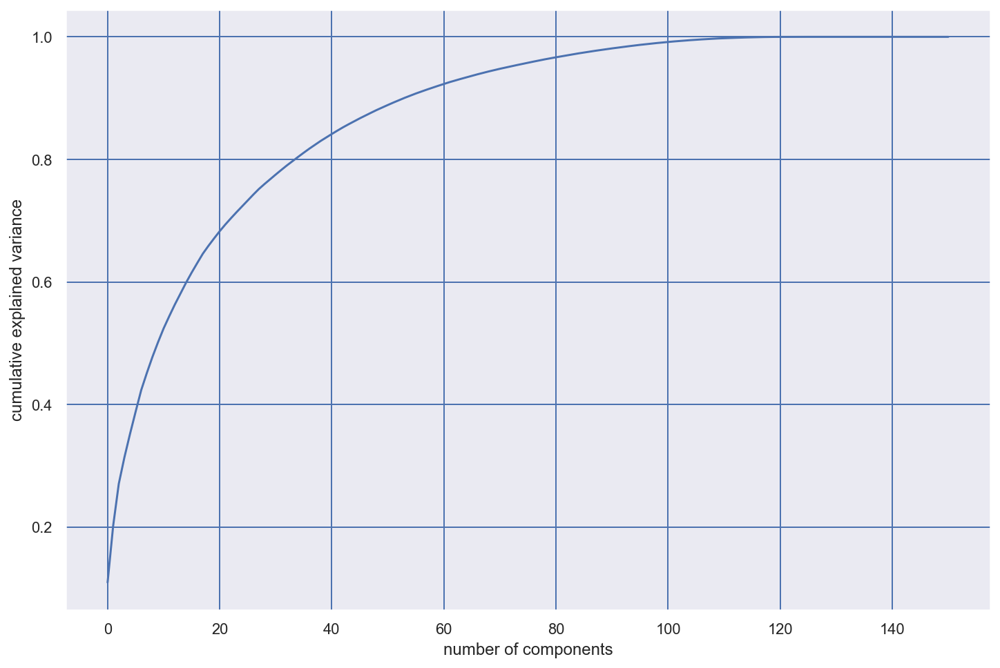

In [297]:
#Making the screeplot - plotting the cumulative variance against the number of components
%matplotlib inline
fig = plt.figure(figsize = (12,8))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.grid(b=True, which='both',axis='both' ,color='b', linestyle='-')
#plt.grid(b=True, which='minor', color='r', linestyle='--')
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')
plt.show()

In [298]:
#Using incremental PCA for efficiency - saves a lot of time on larger datasets
from sklearn.decomposition import IncrementalPCA
pca_final = IncrementalPCA(n_components=80)

In [299]:
X_train_pca = pca_final.fit_transform(X_train_res)
X_train_pca.shape

(38570, 80)

In [300]:
type(X_train_pca)

numpy.ndarray

In [301]:
corrmat = np.corrcoef(X_train_pca.transpose())
# 1s -> 0s in diagonals
corrmat_nodiag = corrmat - np.diagflat(corrmat.diagonal())
print("max corr:",corrmat_nodiag.max(), ", min corr: ", corrmat_nodiag.min(),)

max corr: 0.015363158961279553 , min corr:  -0.011445164486329477


In [302]:
X_train_pca.shape

(38570, 80)

In [303]:
X_train.shape

(20918, 151)

In [304]:
X_test_pca=pca_final.transform(X_test)

In [305]:

X_test_pca.shape

(8965, 80)

In [318]:
#Funciton to print Metrics:
def getMetrics(actual_churn=False,pred_churn=False):

    confusion = metrics.confusion_matrix(actual_churn, pred_churn)

    TP = confusion[1,1] # true positive 
    TN = confusion[0,0] # true negatives
    FP = confusion[0,1] # false positives
    FN = confusion[1,0] # false negatives

    print("Roc_auc_score : {}".format(metrics.roc_auc_score(actual_churn,pred_churn)))
    # Let's see the sensitivity of our logistic regression model
    print('Sensitivity/Recall : {}'.format(TP / float(TP+FN)))
    # Let us calculate specificity
    print('Specificity: {}'.format(TN / float(TN+FP)))
    # Calculate false postive rate - predicting churn when customer does not have churned
    print('False Positive Rate: {}'.format(FP/ float(TN+FP)))
    # positive predictive value 
    print('Positive predictive value: {}'.format(TP / float(TP+FP)))
    # Negative predictive value
    print('Negative Predictive value: {}'.format(TN / float(TN+ FN)))
    # sklearn precision score value 
    print('sklearn precision score value: {}'.format(metrics.precision_score(actual_churn, pred_churn )))

In [319]:
# Funtion to predict the churn using the input probability cut-off
# Input arguments: model instance, x and y to predict using model and cut-off probability

def predictChurnProb(model,X,y,prob):
   
    # predict
    pred_probs = model.predict_proba(X)[:,1]
    
    y_df= pd.DataFrame({'is_churn':y, 'churn_Prob':pred_probs})
    # Creating new column 'predicted' with 1 if Churn_Prob>0.5 else 0
    y_df['final_predicted'] = y_df.churn_Prob.map( lambda x: 1 if x > prob else 0)
    # Let's see the head
    getMetrics(y_df.is_churn,y_df.final_predicted)
    return y_df

In [320]:
 #Function to Draw ROC curve:
    def draw_roc( actual, probs ):
        
    fpr, tpr, thresholds = metrics.roc_curve( actual, probs,
                                              drop_intermediate = False )
    auc_score = metrics.roc_auc_score( actual, probs )
    plt.figure(figsize=(6, 6))
    plt.plot( fpr, tpr, label='ROC curve (area = %0.2f)' % auc_score )
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate or [1 - True Negative Rate]')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic example')
    plt.legend(loc="lower right")
    plt.show()

    return fpr, tpr, thresholds

In [328]:
#Function to find the optimal cutoff for classifing as churn/non-churn
# Let's create columns with different probability cutoffs 

def getOptimalCutoff(df):
    numbers = [float(x)/10 for x in range(10)]
    for i in numbers:
        df[i] = df.churn_Prob.map( lambda x: 1 if x > i else 0)
    #print(df.head())
    
    # Now let's calculate accuracy sensitivity and specificity for various probability cutoffs.
    cutoff_df = pd.DataFrame( columns = ['prob','accuracy','sensi','speci'])
    from sklearn.metrics import confusion_matrix
    
    # TP = confusion[1,1] # true positive 
    # TN = confusion[0,0] # true negatives
    # FP = confusion[0,1] # false positives
    # FN = confusion[1,0] # false negatives
    
    num = [0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9]
    for i in num:
        cm1 = metrics.confusion_matrix(df.is_churn, df[i] )
        total1=sum(sum(cm1))
        accuracy = (cm1[0,0]+cm1[1,1])/total1
        
        speci = cm1[0,0]/(cm1[0,0]+cm1[0,1])
        sensi = cm1[1,1]/(cm1[1,0]+cm1[1,1])
        cutoff_df.loc[i] =[ i ,accuracy,sensi,speci]
    print(cutoff_df)
    # Let's plot accuracy sensitivity and specificity for various probabilities.
    cutoff_df.plot.line(x='prob', y=['accuracy','sensi','speci'])
    plt.show()

In [322]:
#Fit the algorithm on the data
def modelfm(alg, X_train, y_train, performCV=True, cv_folds=5):
    
    alg.fit(X_train, y_train)
        
    #Predict training set:
    dtrain_predictions = alg.predict(X_train)
    dtrain_predprob = alg.predict_proba(X_train)[:,1]
    
    #Perform cross-validation:
    if performCV:
        cv_score = cross_val_score(alg, X_train, y_train, cv=cv_folds, scoring='roc_auc')
    
    #Print model report:
    print ("\nModel Report")
    print ("Accuracy : %.4g" % metrics.roc_auc_score(y_train, dtrain_predictions))
    print ("Recall/Sensitivity : %.4g" % metrics.recall_score(y_train, dtrain_predictions))
    print ("AUC Score (Train): %f" % metrics.roc_auc_score(y_train, dtrain_predprob))
    
    if performCV:
        print ("CV Score : Mean - %.7g | Std - %.7g | Min - %.7g | Max - %.7g" % (np.mean(cv_score),np.std(cv_score),np.min(cv_score),np.max(cv_score)))

<font color = Red size = 5> __Logistic Regression with PCA__ </font>

In [308]:
from sklearn.linear_model import LogisticRegression
from sklearn import metrics

lr0=LogisticRegression()

In [309]:
modelfm(lr0, X_train_pca, y_train_res)


Model Report
Accuracy : 0.8427
Recall/Sensitivity : 0.8568
AUC Score (Train): 0.906874
CV Score : Mean - 0.9054274 | Std - 0.004246027 | Min - 0.8991044 | Max - 0.9116367


In [312]:
# predictions on Test data
pred_probs_test = lr0.predict(X_test_pca)
getMetrics(y_test,pred_probs_test)

Roc_auc_score : 0.8114441355608936
Sensitivity/Recall : 0.7955223880597015
Specificity: 0.8273658830620856
False Positive Rate: 0.17263411693791442
Positive predictive value: 0.2712468193384224
Negative Predictive value: 0.9804285714285714
sklearn precision score value: 0.2712468193384224


In [323]:
cut_off_prob=0.5
y_train_df = predictChurnProb(lr0,X_train_pca,y_train_res,cut_off_prob)
y_train_df.head()

Roc_auc_score : 0.842701581540057
Sensitivity/Recall : 0.8567798807363236
Specificity: 0.8286232823437905
False Positive Rate: 0.1713767176562095
Positive predictive value: 0.8333165220899738
Negative Predictive value: 0.8526304556610821
sklearn precision score value: 0.8333165220899738


,is_churn,churn_Prob,final_predicted
0,1,0.79,1
1,1,0.80,1
2,0,0.16,0
3,1,0.76,1
4,0,0.00,0


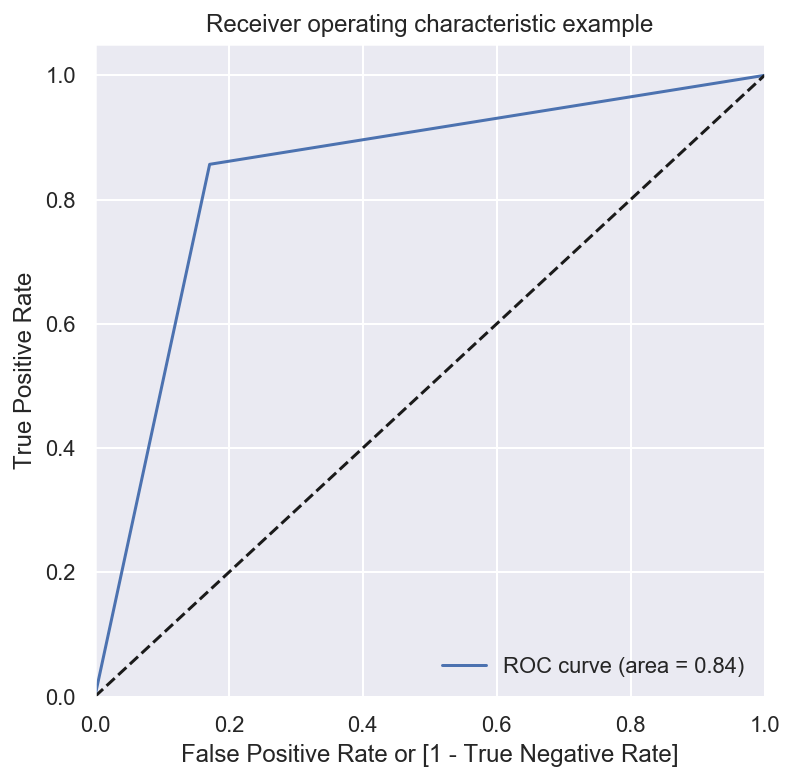

(array([0.        , 0.17137672, 1.        ]),
 array([0.        , 0.85677988, 1.        ]),
 array([2, 1, 0]))

In [324]:
#plotting ROC Curve:
draw_roc(y_train_df.is_churn, y_train_df.final_predicted)

In [325]:

#draw_roc(y_pred_final.Churn, y_pred_final.predicted)
print("roc_auc_score : {:2.2f}".format(metrics.roc_auc_score(y_train_df.is_churn, y_train_df.final_predicted)))

roc_auc_score : 0.84


      prob  accuracy  sensi  speci
0.00  0.00      0.50   1.00   0.00
0.10  0.10      0.70   0.98   0.42
0.20  0.20      0.77   0.95   0.59
0.30  0.30      0.81   0.92   0.69
0.40  0.40      0.83   0.89   0.77
0.50  0.50      0.84   0.86   0.83
0.60  0.60      0.84   0.81   0.88
0.70  0.70      0.83   0.75   0.91
0.80  0.80      0.79   0.64   0.94
0.90  0.90      0.63   0.28   0.98


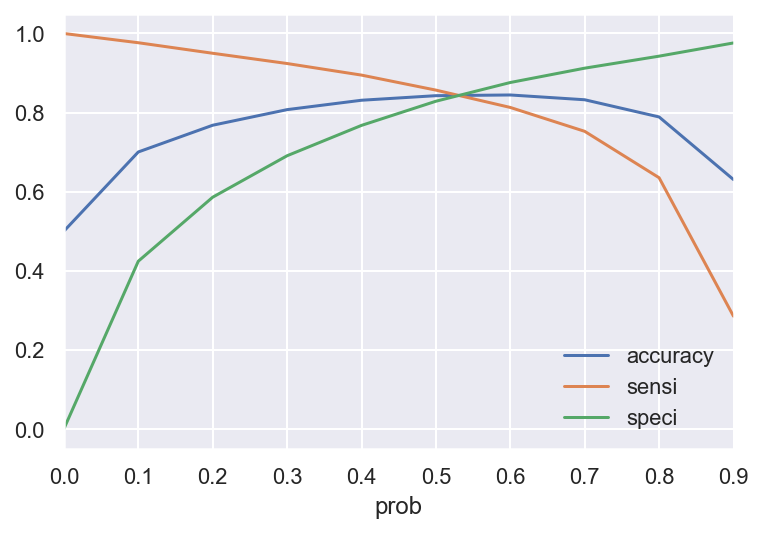

In [329]:
# finding cut-off with the right balance of the metrices
# sensitivity vs specificity trade-off
getOptimalCutoff(y_train_df)

In [330]:
# predicting with the choosen cut-off on train
cut_off_prob = 0.55
predictChurnProb(lr0,X_train_pca,y_train_res,cut_off_prob)

Roc_auc_score : 0.8444905366865441
Sensitivity/Recall : 0.835882810474462
Specificity: 0.8530982628986259
False Positive Rate: 0.14690173710137414
Positive predictive value: 0.8505249828523189
Negative Predictive value: 0.8386603456185961
sklearn precision score value: 0.8505249828523189


,is_churn,churn_Prob,final_predicted
0,1,0.79,1
1,1,0.80,1
2,0,0.16,0
3,1,0.76,1
4,0,0.00,0
5,0,0.90,1
6,0,0.26,0
7,1,0.94,1
8,0,0.02,0
9,1,0.89,1


In [331]:
predictChurnProb(lr0,X_test_pca,y_test,cut_off_prob)

Roc_auc_score : 0.8107527462146771
Sensitivity/Recall : 0.7701492537313432
Specificity: 0.8513562386980108
False Positive Rate: 0.14864376130198914
Positive predictive value: 0.2950257289879931
Negative Predictive value: 0.9786585365853658
sklearn precision score value: 0.2950257289879931


,is_churn,churn_Prob,final_predicted
5609,0,0.10,0
16260,0,0.78,1
75283,0,0.01,0
68179,0,0.03,0
19146,0,0.26,0
24911,0,0.73,1
334,0,0.68,1
80860,0,0.14,0
15424,0,0.64,1
71425,0,0.86,1


<font color=blue size=5> Inference: </font>
- The resulting model, after PCA and logistic regression (with optimal cutoff setting) 
has a right balance of different metrics score for sensitivity, specificity and Roc Accuracy on the train 
and test set.

train sensitivity : 83.58%,
test sensitivity : 77.01%, 
precision: 29.5%


<font color=Magenta size=5> Decision Tree with PCA: </font>

### Applying Decision Tree Classifier on our principal components with Hyperparameter tuning¶

In [334]:
from sklearn.tree import DecisionTreeClassifier

dt0 = DecisionTreeClassifier(max_features='auto',
                             min_samples_split=100,
                             min_samples_leaf=100,
                             max_depth=6,
                             random_state=10)
modelfm(dt0, X_train_pca, y_train_res)


Model Report
Accuracy : 0.7481
Recall/Sensitivity : 0.7636
AUC Score (Train): 0.814774
CV Score : Mean - 0.7858668 | Std - 0.005732947 | Min - 0.7778705 | Max - 0.794538


In [335]:
# make predictions
pred_probs_test = dt0.predict(X_test_pca)
#Let's check the model metrices.
getMetrics(actual_churn=y_test,pred_churn=pred_probs_test)

Roc_auc_score : 0.6689482065261396
Sensitivity/Recall : 0.6268656716417911
Specificity: 0.7110307414104883
False Positive Rate: 0.2889692585895118
Positive predictive value: 0.14909478168264112
Negative Predictive value: 0.9593363695510735
sklearn precision score value: 0.14909478168264112


In [336]:
param_grid = {
    'max_depth': range(5,15,3),
    'min_samples_leaf': range(100, 400, 50),
    'min_samples_split': range(100, 400, 100),
    'max_features': [8,10,15]
}
# Create a based model
dt = DecisionTreeClassifier(random_state=10)
# Instantiate the grid search model
grid_search = GridSearchCV(estimator = dt, param_grid = param_grid, 
                          cv = 3, n_jobs = 4,verbose = 1,scoring="f1_weighted")

In [337]:
# Fit the grid search to the data
grid_search.fit(X_train_pca, y_train_res)


Fitting 3 folds for each of 216 candidates, totalling 648 fits


[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    3.7s
[Parallel(n_jobs=4)]: Done 192 tasks      | elapsed:   12.4s
[Parallel(n_jobs=4)]: Done 442 tasks      | elapsed:   40.4s
[Parallel(n_jobs=4)]: Done 648 out of 648 | elapsed:  2.1min finished


GridSearchCV(cv=3, estimator=DecisionTreeClassifier(random_state=10), n_jobs=4,
             param_grid={'max_depth': range(5, 15, 3),
                         'max_features': [8, 10, 15],
                         'min_samples_leaf': range(100, 400, 50),
                         'min_samples_split': range(100, 400, 100)},
             scoring='f1_weighted', verbose=1)

In [338]:
# printing the optimal accuracy score and hyperparameters
print('Recall of',grid_search.best_score_,'using',grid_search.best_params_)


Recall of 0.7885672279711334 using {'max_depth': 14, 'max_features': 15, 'min_samples_leaf': 100, 'min_samples_split': 100}


In [340]:
# model with the best hyperparameters
des_tree = DecisionTreeClassifier(
                             max_depth=14,
                             min_samples_leaf=100, 
                             min_samples_split=100,
                             max_features=15,
                             random_state=10)

In [342]:
modelfm(des_tree,X_train_pca,y_train_res)



Model Report
Accuracy : 0.8202
Recall/Sensitivity : 0.8165
AUC Score (Train): 0.907129
CV Score : Mean - 0.8784194 | Std - 0.007985265 | Min - 0.8652229 | Max - 0.8903424


In [255]:
from sklearn.ensemble import RandomForestClassifier

In [345]:
# make predictions  on test:
pred_probs_test = des_tree.predict(X_test_pca)
#Let's check the model metrices.
getMetrics(actual_churn=y_test,pred_churn=pred_probs_test)

Roc_auc_score : 0.7171268431801211
Sensitivity/Recall : 0.6358208955223881
Specificity: 0.7984327908378541
False Positive Rate: 0.20156720916214588
Positive predictive value: 0.20305052430886558
Negative Predictive value: 0.9644677442842581
sklearn precision score value: 0.20305052430886558


In [347]:
# classification report
from sklearn.metrics import classification_report

print(classification_report(y_test,pred_probs_test))

              precision    recall  f1-score   support

           0       0.96      0.80      0.87      8295
           1       0.20      0.64      0.31       670

    accuracy                           0.79      8965
   macro avg       0.58      0.72      0.59      8965
weighted avg       0.91      0.79      0.83      8965



In [416]:
# predicting churn with default cut-off 0.5
cut_off_prob = 0.5
y_train_df = predictChurnProb(des_tree,X_train_pca,y_train_res,cut_off_prob)
y_train_df.head()

Roc_auc_score : 0.8202488981073374
Sensitivity/Recall : 0.8164894996110967
Specificity: 0.8240082966035779
False Positive Rate: 0.1759917033964221
Positive predictive value: 0.822675026123302
Negative Predictive value: 0.8178589809572826
sklearn precision score value: 0.822675026123302


,is_churn,churn_Prob,final_predicted
0,1,0.78,1
1,1,0.67,1
2,0,0.00,0
3,1,0.92,1
4,0,0.00,0


      prob  accuracy  sensi  speci
0.00  0.00      0.59   1.00   0.18
0.10  0.10      0.71   0.99   0.43
0.20  0.20      0.76   0.97   0.56
0.30  0.30      0.79   0.94   0.64
0.40  0.40      0.81   0.89   0.73
0.50  0.50      0.82   0.82   0.82
0.60  0.60      0.81   0.75   0.88
0.70  0.70      0.80   0.67   0.92
0.80  0.80      0.76   0.56   0.96
0.90  0.90      0.71   0.44   0.98


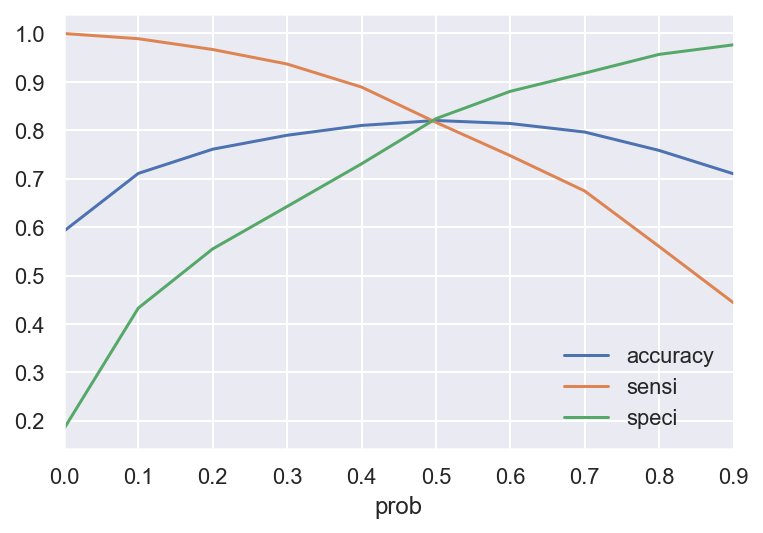

In [424]:
# finding cut-off with the right balance of the metrices
getOptimalCutoff(y_train_df)

In [430]:
# predicting churn with cut-off 0.5 only as it is balancing all three accuracy, sensitivity specifity
cut_off_prob=0.5
y_train_df = predictChurnProb(des_tree,X_train_pca,y_train_res,cut_off_prob)
y_train_df.head()

Roc_auc_score : 0.8202488981073374
Sensitivity/Recall : 0.8164894996110967
Specificity: 0.8240082966035779
False Positive Rate: 0.1759917033964221
Positive predictive value: 0.822675026123302
Negative Predictive value: 0.8178589809572826
sklearn precision score value: 0.822675026123302


,is_churn,churn_Prob,final_predicted
0,1,0.78,1
1,1,0.67,1
2,0,0.00,0
3,1,0.92,1
4,0,0.00,0


In [431]:
#Lets see how it performs on test data.
y_test_df= predictChurnProb(des_tree,X_test_pca,y_test,cut_off_prob)
y_test_df.head()

Roc_auc_score : 0.7171268431801211
Sensitivity/Recall : 0.6358208955223881
Specificity: 0.7984327908378541
False Positive Rate: 0.20156720916214588
Positive predictive value: 0.20305052430886558
Negative Predictive value: 0.9644677442842581
sklearn precision score value: 0.20305052430886558


,is_churn,churn_Prob,final_predicted
5609,0,0.01,0
16260,0,0.72,1
75283,0,0.14,0
68179,0,0.00,0
19146,0,0.01,0


<font color=Blue size=5>Inference:</font>

- Even after hyperparameter tuning for the Decision Tree, Recall rate is **63.58%** which is not very significant to predict the churn.


- train sensitivity : 78.85%,
- test sensitivity : 63.58%, 
- precision: 20.3%


- Let's see if we can achive a better Recall rate by deciding an optimal cut-off for the model to predict churn.

### Hyper parameter tuning :

<font color = GoldBlack size = 5> __Random Forest with PCA__ </font>

In [348]:
from sklearn.ensemble import RandomForestClassifier

In [349]:
rfc=RandomForestClassifier()

In [350]:
rfc.fit(X_train_pca,y_train_res)

RandomForestClassifier()

In [351]:
predictions = rfc.predict(X_test_pca)

In [352]:
getMetrics(y_test,predictions)

Roc_auc_score : 0.6895544879580398
Sensitivity/Recall : 0.4223880597014925
Specificity: 0.9567209162145871
False Positive Rate: 0.0432790837854129
Positive predictive value: 0.440809968847352
Negative Predictive value: 0.9535023429052024
sklearn precision score value: 0.440809968847352


In [354]:
# Let's check the report of our default model
print(classification_report(y_test,predictions))

              precision    recall  f1-score   support

           0       0.95      0.96      0.96      8295
           1       0.44      0.42      0.43       670

    accuracy                           0.92      8965
   macro avg       0.70      0.69      0.69      8965
weighted avg       0.92      0.92      0.92      8965



In [355]:
# Printing confusion matrix
print(confusion_matrix(y_test,predictions))

[[7936  359]
 [ 387  283]]


In [357]:
# Importing accuracy_score from sklearn metrics
from sklearn.metrics import  accuracy_score

In [358]:
print(accuracy_score(y_test,predictions))

0.9167875069715561


### Applying Random Forest Classifier on our principal components with Hyperparameter tuning¶


In [359]:
# instantiate the model
rf = RandomForestClassifier()

### Tuning n_estimators


In [361]:
# GridSearchCV to find optimal n_estimators
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV


# specify number of folds for k-fold CV
n_folds = 3

# parameters to build the model on
parameters = {'n_estimators': range(100, 400, 50)}

# instantiate the model (note we are specifying a max_depth)
rf = RandomForestClassifier()


# fit tree on training data
rf1 = GridSearchCV(rf, parameters,cv=3,scoring='accuracy',verbose=2,n_jobs=-1,return_train_score=True)
rf1.fit(X_train_pca, y_train_res)

Fitting 3 folds for each of 6 candidates, totalling 18 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of  18 | elapsed:  3.5min remaining:  9.1min
[Parallel(n_jobs=-1)]: Done  15 out of  18 | elapsed:  7.6min remaining:  1.5min
[Parallel(n_jobs=-1)]: Done  18 out of  18 | elapsed:  8.8min finished


GridSearchCV(cv=3, estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'n_estimators': range(100, 400, 50)},
             return_train_score=True, scoring='accuracy', verbose=2)

In [362]:
# scores of GridSearch CV
scores = rf1.cv_results_
pd.DataFrame(scores).head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_estimators,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,mean_train_score,std_train_score
0,152.22,0.81,1.05,0.02,100,{'n_estimators': 100},0.96,0.95,0.96,0.96,0.00,6,1.00,1.00,1.00,1.00,0.00
1,203.46,2.09,1.88,0.17,150,{'n_estimators': 150},0.96,0.96,0.96,0.96,0.00,5,1.00,1.00,1.00,1.00,0.00
2,282.95,1.29,1.83,0.13,200,{'n_estimators': 200},0.96,0.96,0.96,0.96,0.00,4,1.00,1.00,1.00,1.00,0.00
3,322.74,1.49,2.00,0.01,250,{'n_estimators': 250},0.96,0.96,0.96,0.96,0.00,3,1.00,1.00,1.00,1.00,0.00
4,292.82,2.31,1.65,0.02,300,{'n_estimators': 300},0.96,0.96,0.96,0.96,0.00,2,1.00,1.00,1.00,1.00,0.00


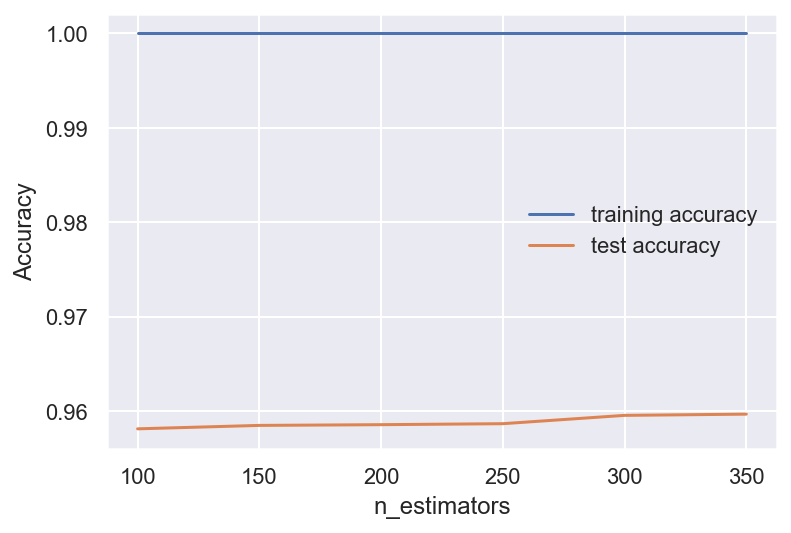

In [363]:
# plotting accuracies with n_estimators
plt.figure()
plt.plot(scores["param_n_estimators"], 
         scores["mean_train_score"], 
         label="training accuracy")
plt.plot(scores["param_n_estimators"], 
         scores["mean_test_score"], 
         label="test accuracy")
plt.xlabel("n_estimators")
plt.ylabel("Accuracy")
plt.legend()
plt.show()




### Tuning Max_depth

In [364]:
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV


# specify number of folds for k-fold CV
n_folds = 3

# parameters to build the model on
parameters = {'max_depth': range(10, 30, 5),
              'n_estimators':[250]}



# fit tree on training data
rf1 = GridSearchCV(rf, parameters,cv=3,scoring='accuracy',verbose=2,n_jobs=-1,return_train_score=True)
rf1.fit(X_train_pca, y_train_res)

Fitting 3 folds for each of 4 candidates, totalling 12 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of  12 | elapsed:  3.8min remaining: 11.5min
[Parallel(n_jobs=-1)]: Done  10 out of  12 | elapsed:  4.9min remaining:   58.3s
[Parallel(n_jobs=-1)]: Done  12 out of  12 | elapsed:  4.9min finished


GridSearchCV(cv=3, estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'max_depth': range(10, 30, 5), 'n_estimators': [250]},
             return_train_score=True, scoring='accuracy', verbose=2)

In [365]:
# scores of GridSearch CV
scores = rf1.cv_results_
print(pd.DataFrame(scores).head())

   mean_fit_time  std_fit_time  mean_score_time  std_score_time  \
0         221.20          0.31             1.94            0.01   
1         258.61          0.25             1.53            0.05   
2         274.43          0.33             1.56            0.02   
3         284.34          1.08             1.76            0.02   

  param_max_depth param_n_estimators                                  params  \
0              10                250  {'max_depth': 10, 'n_estimators': 250}   
1              15                250  {'max_depth': 15, 'n_estimators': 250}   
2              20                250  {'max_depth': 20, 'n_estimators': 250}   
3              25                250  {'max_depth': 25, 'n_estimators': 250}   

   split0_test_score  split1_test_score  split2_test_score  mean_test_score  \
0               0.91               0.91               0.92             0.91   
1               0.95               0.95               0.95             0.95   
2               0.95      

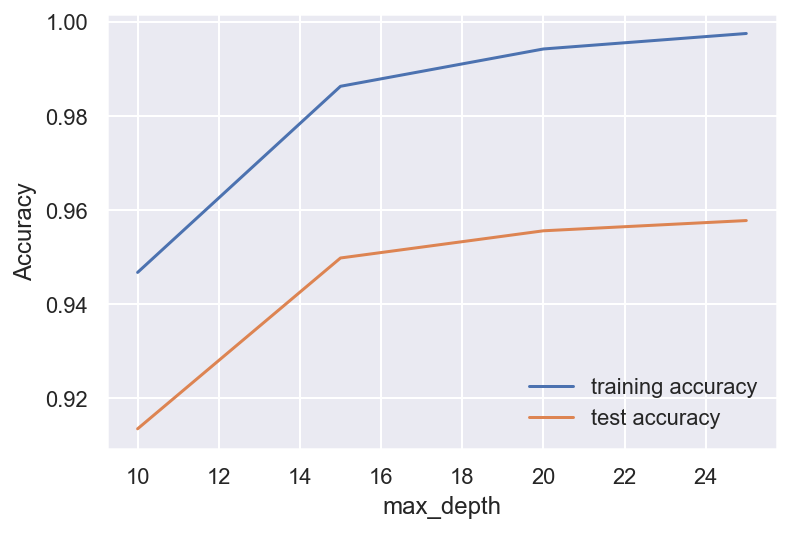

In [368]:
# plotting accuracies with max_depth
plt.figure()
plt.plot(scores["param_max_depth"], 
         scores["mean_train_score"], 
         label="training accuracy")
plt.plot(scores["param_max_depth"], 
         scores["mean_test_score"], 
         label="test accuracy")
plt.xlabel("max_depth")
plt.ylabel("Accuracy")
plt.legend()
plt.show()

###  Tuning max_features


In [386]:
# parameters to build the model on
parameters = {'max_features': range(5,25, 5),'n_estimators':[150]}


# fit tree on training data
rf1 = GridSearchCV(rf, parameters,cv=3,scoring='accuracy',verbose=2,n_jobs=-1,return_train_score=True)
rf1.fit(X_train_pca, y_train_res)

Fitting 3 folds for each of 4 candidates, totalling 12 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of  12 | elapsed:   38.6s remaining:  1.9min
[Parallel(n_jobs=-1)]: Done  10 out of  12 | elapsed:  2.4min remaining:   28.9s
[Parallel(n_jobs=-1)]: Done  12 out of  12 | elapsed:  2.5min finished


GridSearchCV(cv=3, estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'max_features': range(5, 25, 5),
                         'n_estimators': [150]},
             return_train_score=True, scoring='accuracy', verbose=2)

In [387]:
# scores of GridSearch CV
scores = rf1.cv_results_
pd.DataFrame(scores).head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_features,param_n_estimators,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,mean_train_score,std_train_score
0,34.51,0.22,0.60,0.03,5,150,"{'max_features': 5, 'n_estimators': 150}",0.96,0.96,0.96,0.96,0.00,1,1.00,1.00,1.00,1.00,0.00
1,63.40,0.75,0.45,0.01,10,150,"{'max_features': 10, 'n_estimators': 150}",0.96,0.96,0.96,0.96,0.00,2,1.00,1.00,1.00,1.00,0.00
2,89.27,0.89,0.63,0.02,15,150,"{'max_features': 15, 'n_estimators': 150}",0.96,0.95,0.96,0.96,0.00,3,1.00,1.00,1.00,1.00,0.00
3,141.77,1.74,0.79,0.08,20,150,"{'max_features': 20, 'n_estimators': 150}",0.96,0.95,0.96,0.96,0.00,4,1.00,1.00,1.00,1.00,0.00


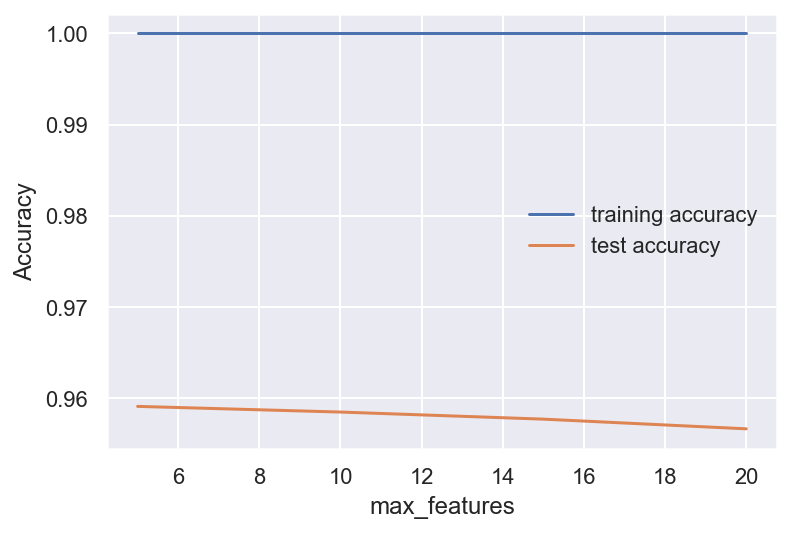

In [388]:
# plotting accuracies with max_features
plt.figure()
plt.plot(scores["param_max_features"], 
         scores["mean_train_score"], 
         label="training accuracy")
plt.plot(scores["param_max_features"], 
         scores["mean_test_score"], 
         label="test accuracy")
plt.xlabel("max_features")
plt.ylabel("Accuracy")
plt.legend()
plt.show()


### Tuning min_sample_split

In [383]:
# parameters to build the model on
parameters = {'min_samples_split': range(50, 500, 50),
              'n_estimators':[150]}


# fit tree on training data
rf1 = GridSearchCV(rf, parameters,cv=3,scoring='accuracy',verbose=2,n_jobs=-1,return_train_score=True)
rf1.fit(X_train_pca, y_train_res)

Fitting 3 folds for each of 9 candidates, totalling 27 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 out of  27 | elapsed:  2.7min remaining:  1.3min
[Parallel(n_jobs=-1)]: Done  27 out of  27 | elapsed:  3.2min finished


GridSearchCV(cv=3, estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'min_samples_split': range(50, 500, 50),
                         'n_estimators': [150]},
             return_train_score=True, scoring='accuracy', verbose=2)

In [384]:
# scores of GridSearch CV
scores = rf1.cv_results_
print(pd.DataFrame(scores).head())

   mean_fit_time  std_fit_time  mean_score_time  std_score_time  \
0          64.20          2.05             1.44            0.11   
1          58.18          1.13             0.99            0.16   
2          52.03          0.93             0.74            0.07   
3          48.54          0.76             0.57            0.03   
4         107.09          1.09             0.49            0.01   

  param_min_samples_split param_n_estimators  \
0                      50                150   
1                     100                150   
2                     150                150   
3                     200                150   
4                     250                150   

                                            params  split0_test_score  \
0   {'min_samples_split': 50, 'n_estimators': 150}               0.92   
1  {'min_samples_split': 100, 'n_estimators': 150}               0.89   
2  {'min_samples_split': 150, 'n_estimators': 150}               0.88   
3  {'min_samples

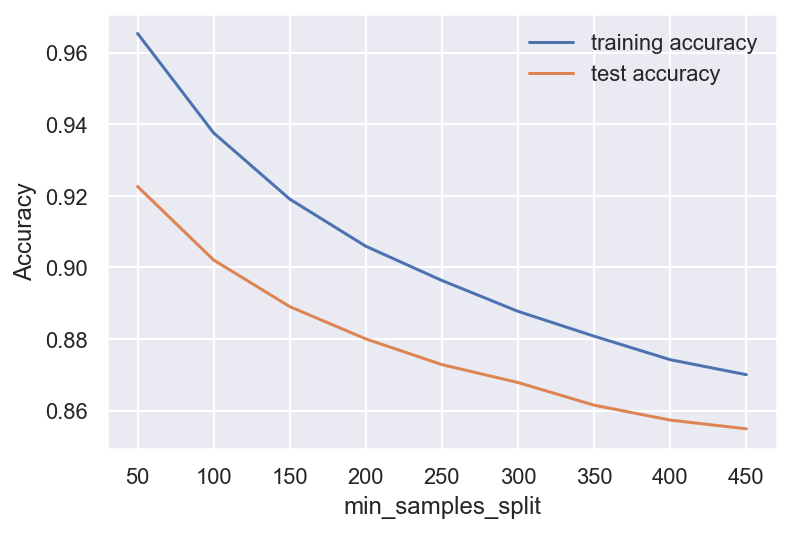

In [385]:
#plotting accuracies with min_samples_split
plt.figure()
plt.plot(scores["param_min_samples_split"], 
         scores["mean_train_score"], 
         label="training accuracy")
plt.plot(scores["param_min_samples_split"], 
         scores["mean_test_score"], 
         label="test accuracy")
plt.xlabel("min_samples_split")
plt.ylabel("Accuracy")
plt.legend()
plt.show()


### Tuning min_sample_leaf

In [379]:
#parameters to build the model on
parameters = {'min_samples_leaf': range(50, 400, 50),
              'n_estimators':[150]}

# fit tree on training data
rf1 = GridSearchCV(rf, parameters,cv=3,scoring='accuracy',verbose=2,n_jobs=-1,return_train_score=True)
rf1.fit(X_train_pca, y_train_res)

Fitting 3 folds for each of 7 candidates, totalling 21 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done   9 out of  21 | elapsed:   48.1s remaining:  1.1min
[Parallel(n_jobs=-1)]: Done  21 out of  21 | elapsed:  1.6min finished


GridSearchCV(cv=3, estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'min_samples_leaf': range(50, 400, 50),
                         'n_estimators': [150]},
             return_train_score=True, scoring='accuracy', verbose=2)

In [381]:
#scores of GridSearch CV
scores = rf1.cv_results_
pd.DataFrame(scores).head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_min_samples_leaf,param_n_estimators,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,mean_train_score,std_train_score
0,56.04,0.99,0.78,0.04,50,150,"{'min_samples_leaf': 50, 'n_estimators': 150}",0.87,0.88,0.89,0.88,0.01,1,0.90,0.90,0.90,0.90,0.00
1,45.98,0.21,0.66,0.00,100,150,"{'min_samples_leaf': 100, 'n_estimators': 150}",0.85,0.86,0.87,0.86,0.01,2,0.88,0.88,0.88,0.88,0.00
2,40.51,0.34,0.61,0.01,150,150,"{'min_samples_leaf': 150, 'n_estimators': 150}",0.85,0.85,0.86,0.85,0.00,3,0.87,0.86,0.86,0.86,0.00
3,36.79,0.36,0.52,0.02,200,150,"{'min_samples_leaf': 200, 'n_estimators': 150}",0.83,0.85,0.85,0.84,0.01,4,0.86,0.85,0.85,0.85,0.00
4,54.99,0.21,0.57,0.07,250,150,"{'min_samples_leaf': 250, 'n_estimators': 150}",0.83,0.84,0.85,0.84,0.01,5,0.85,0.85,0.85,0.85,0.00


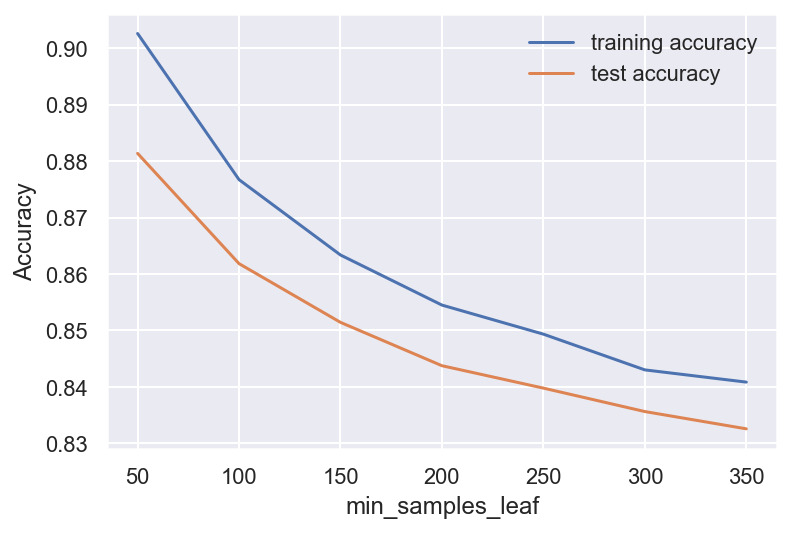

In [382]:
# plotting accuracies with min_samples_leaf
plt.figure()
plt.plot(scores["param_min_samples_leaf"], 
         scores["mean_train_score"], 
         label="training accuracy")
plt.plot(scores["param_min_samples_leaf"], 
         scores["mean_test_score"], 
         label="test accuracy")
plt.xlabel("min_samples_leaf")
plt.ylabel("Accuracy")
plt.legend()
plt.show()

### Tuned RandomForest Model:

In [389]:
rf_final = RandomForestClassifier(max_depth=20,
                                  n_estimators=150,
                                  max_features=5,
                                  min_samples_leaf=100,
                                  min_samples_split=50,
                                  random_state=10)

In [391]:
modelfm(rf_final,X_train_pca,y_train_res)


Model Report
Accuracy : 0.8861
Recall/Sensitivity : 0.8598
AUC Score (Train): 0.952861
CV Score : Mean - 0.9355113 | Std - 0.006149422 | Min - 0.9253294 | Max - 0.9438912


In [392]:
# predict on test data
predictions = rf_final.predict(X_test_pca)

In [394]:
# predicting churn with default cut-off 0.5
cut_off_prob=0.5
y_train_df = predictChurnProb(rf_final,X_train_pca,y_train_res,cut_off_prob)
y_train_df.head()

Roc_auc_score : 0.8860772621208193
Sensitivity/Recall : 0.859839253305678
Specificity: 0.9123152709359605
False Positive Rate: 0.08768472906403942
Positive predictive value: 0.9074590926503584
Negative Predictive value: 0.8668276099916243
sklearn precision score value: 0.9074590926503584


,is_churn,churn_Prob,final_predicted
0,1,0.69,1
1,1,0.58,1
2,0,0.12,0
3,1,0.74,1
4,0,0.08,0


      prob  accuracy  sensi  speci
0.00  0.00      0.50   1.00   0.00
0.10  0.10      0.51   1.00   0.02
0.20  0.20      0.62   1.00   0.25
0.30  0.30      0.79   0.99   0.59
0.40  0.40      0.88   0.94   0.81
0.50  0.50      0.89   0.86   0.91
0.60  0.60      0.83   0.71   0.96
0.70  0.70      0.75   0.53   0.98
0.80  0.80      0.66   0.33   0.99
0.90  0.90      0.57   0.15   1.00


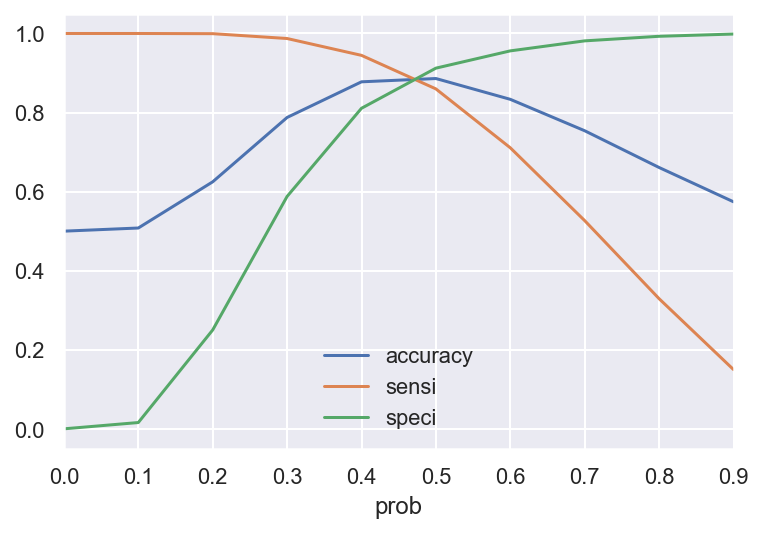

In [395]:
# finding cut-off with the right balance of the metrices
getOptimalCutoff(y_train_df)

In [396]:
cut_off_prob=0.45
predictChurnProb(rf_final,X_train_pca,y_train_res,cut_off_prob)

Roc_auc_score : 0.8899662950479648
Sensitivity/Recall : 0.9097225823178636
Specificity: 0.8702100077780659
False Positive Rate: 0.12978999222193416
Positive predictive value: 0.8751434129794982
Negative Predictive value: 0.9060087458834962
sklearn precision score value: 0.8751434129794982


,is_churn,churn_Prob,final_predicted
0,1,0.69,1
1,1,0.58,1
2,0,0.12,0
3,1,0.74,1
4,0,0.08,0
5,0,0.60,1
6,0,0.24,0
7,1,0.86,1
8,0,0.25,0
9,1,0.65,1


### Making Predictions on test:

In [398]:
y_test_df= predictChurnProb(rf_final,X_test_pca,y_test,cut_off_prob)
y_test_df.head()

Roc_auc_score : 0.7970702545140482
Sensitivity/Recall : 0.7388059701492538
Specificity: 0.8553345388788427
False Positive Rate: 0.14466546112115733
Positive predictive value: 0.2920353982300885
Negative Predictive value: 0.9759284731774416
sklearn precision score value: 0.2920353982300885


,is_churn,churn_Prob,final_predicted
5609,0,0.21,0
16260,0,0.55,1
75283,0,0.22,0
68179,0,0.23,0
19146,0,0.30,0


<font color=Blue size=5>Inference:</font>

- After hyperparameter tuning for the Decision Tree, Recall rate is **73.88%** which is very significant to predict the churn.
- train sensitivity : 85.9%,
- test sensitivity : 73.88%, 
- precision: 29.20%


In [445]:
modelfm(rf_final,X_train_res,y_train_res)


Model Report
Accuracy : 0.9223
Recall/Sensitivity : 0.9012
AUC Score (Train): 0.977469
CV Score : Mean - 0.9721776 | Std - 0.006076375 | Min - 0.9604756 | Max - 0.9780274


<font size=5 color=GoldGreen> __Inference for Best Feature__:</font>

> With PCA among the below 3 model:  
   
-    **Logisitc  :**
        train sensitivity : 84%, test sensitivity : 77%, precision: 30%

-    **Desicion Tree :**
        train sensitivity : 79%, test sensitivity : 64%, precision: 20%
    
-    **Random Forest :**
        train sensitivity : 86%, test sensitivity : 74%, precision: 29%


<font color = Red> __Logistic Regression__ </font>model with probability cut-off = 0.55, performs best.
- It achieved the best recall & accuracy of 77% & 30% for test data.    

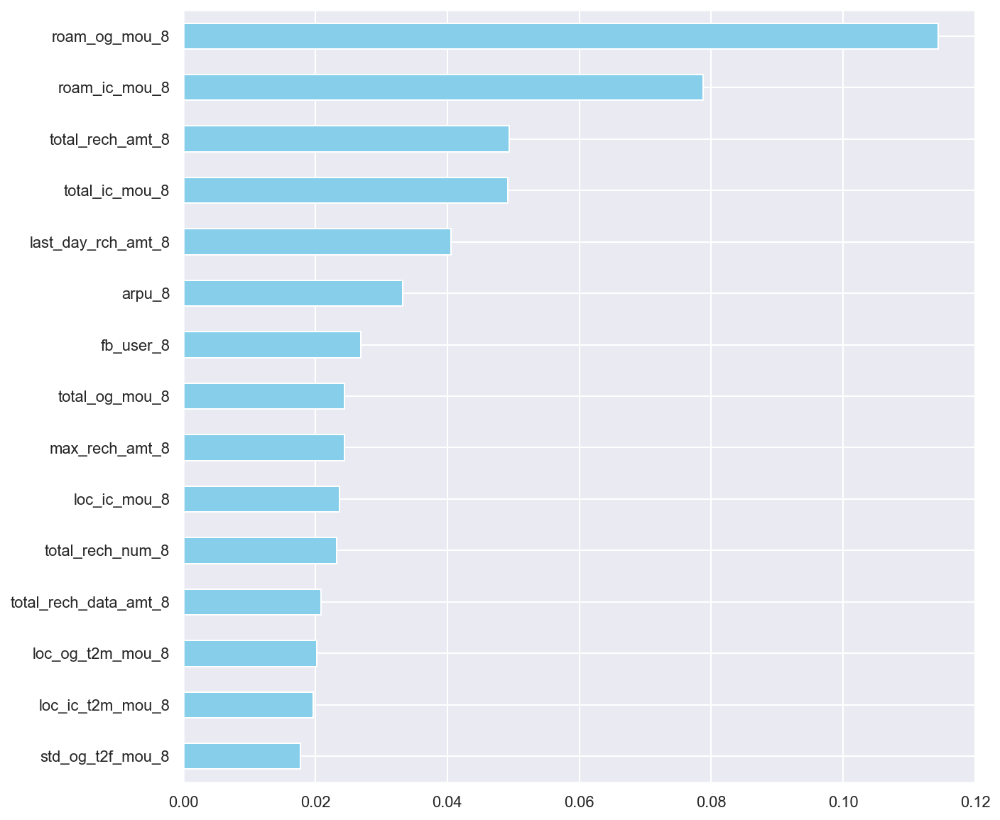

In [466]:
plt.figure(figsize = (10,10))

X = df_bkp.drop(['is_churn'],axis=1)
imp_feat = pd.Series(rf_final.feature_importances_, index = X.columns )
imp_feat.nlargest(15).sort_values().plot(kind = 'barh',align = 'center',color='skyblue')

<font color=Magenta size=5> __KPI - Features:__</font>


Some of the top main predictiors of churn are the monthly KPI features which are 3rd month :August(action phase).

the graph above suggest that the top 15 features ranked in order of importance as produced by our RandomForest implementation are the features that belong to month 8 i.e., the action month. Hence, it is clear that what happens in the action phase has a direct impact on the customer churn of high value customers. Specifically, these features are as follows:

- roam_og_mou_8 -- outgoing roaming calls minutes of usage in month 8
- roam_ic_mou_8 -- incoming roaming calls minutes of usage in month 8
- total_rech_amt_8 -- total recharge amount in month 8
- total_ic_mou_8 -- Total incoming minutes of usage in month 8
- last_day_rch_amt_8 -- last (most recent) recharge amount in month 8
- arpu_8 -- average revenue per user in month 8
- fb_user_8 -- services of Facebook and similar social networking sites for month 8
- total_og_mou_8 -- total outgoing calls minutes of usage in month 8
- max_rech_amt_8 -- maximum recharge amount in month 8
- loc_ic_mou_8 -- local incoming minutes of usage in month 8
- total_rech_num_8 -- total number of recharges done in the month 8
- total_rech_data_amt_8 -- total recharge amount for data in month 8
- loc_og_t2n_mou_8 -- local outgoing calls minutes of usage to other operator mobile in month 8
- loc_ic_t2t_mou_8 -- local incoming calls from same operator minutes of usage in month 8
- std_og_t2f_mou_8 -- std outgoing calls from our operator to fixed lines in month 8

__Logistic__:
- arpu_7 -- average revenue per user in month 7.
- average_rech_6_7 -- Average Recharge of 6 & 7 months.

Local calls Mou's be it incoming or outgoing have a very important role for churn predictions. Reduction in these KPI's forms a clear indicator of churn.

We can estimate that, drop in any of these KPI's resembles the customer is not actively utilizing the services offered by the Network operator and thus may choose to churn in the near future.

Next, we will look at some of the stratergic steps which can be taken to retain these predicted churners.



<font color=Green size=5> __Insights & Summary:__</font>



- Behaviour is 8 Month can be the base of Churn Analysis
- Very Less Amount of High Value customers are churning which is a good service indicator
- Large no of Customers are new to Telecom Company.
- Local Outgoing Calls and Revenue Per Customer are strong indicators of Churn in 8th month.
- People with less than 4 Yrs of Tenure are more likely to Churn
- Behaviour of Volume Based Cost is not a strong indicator of Churn
- Max Recharge Amount & Roaming recharge could be good Churn Indicators.

- Logistic is the best method to Predict Churn followed by RandomForest, other models too do a fair job